# Fake Text Detection with Steering Vectors:

Это первая часть исследования с моделью LLama-2-7b-hf.
- Фейковые и реальные тексты для построения стиринг векторов взяты из COLING (https://huggingface.co/datasets/Jinyan1/COLING_2025_MGT_en).
- Для активаци и стиринг вектороф были созданы графики магнитуды, косинусного подобия от слоя а слою, heat-Map усредненного стиринг вектора, а тaкже T-SNE, PCA и UMAP каждого слоя относительно меток и график дисперсии классов по слоям.
- Для задачи детектирования фейковых текстов был изначально взят домен текстов с reddit - тренировачное и тестовое множества. Из активации стоев и стиринг ветороа былы посчитаны проекции фейковости и обучены три классификатора: логистическая регрессия, random forest и SVM.
- Для каждого из классификаторов были постоены графики и посчитаны основные метрики. Классификаторы были обучены на каждом слое, чтобы понять какая активация какого слоя лучше всего подходит для детекции фейковых текстов.
- Пункт выше также был проделан для тренировки классификаторов на стиринг векторах одного домена (в моем случае reddit) и теста на текстах другого домена (в моем случае домены financial, medical). Идея переноса на именно эти домены возникла по причине специфичности этих текстов: фининсовые и медицинские тексты имеют определенную структуру и термины, которых необходимо придерживаться - как человеку, так и машине. Это привносит определенную сложность в детектирование таких текстов, т.к. кретивность в этих текстах неуместна и человеку приходится придерживаться определенного стиля и "стандарта".

### Загрузка необходимых библиотек: при первом запуске необходимо создать venv (virtual environment) и выбрать его для последующей работы. В него необходимо установить библиотеки: это можно сделать либо через pip следующих сточек команд, либо через терминал из requirements.txt.

In [ ]:
#%pip install -U datasets steering-vectors accelerate bitsandbytes #%
#%pip install umap-learn, transformers

In [ ]:
import torch
print(torch.version.cuda)
print(torch.cuda.is_available())
print(torch.cuda.device_count())
print(torch.cuda.get_device_name(0) if torch.cuda.is_available() else "No CUDA device")
import steering_vectors
from transformers import AutoTokenizer, AutoModelForCausalLM
import datasets
%pip install seaborn
import seaborn as sns
import numpy as np
import pandas as pd
#import matplotlib.pyplot as plt
from matplotlib import pyplot as plt
from sklearn.metrics import roc_auc_score
from copy import copy

import math
from collections.abc import Iterable
from dataclasses import dataclass

from tqdm import tqdm
from transformers import PreTrainedModel as Model
from transformers import PreTrainedTokenizerBase as Tokenizer
from typing import Dict, List, Tuple, Optional, Any
import pickle
import os
import sys
import logging

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
%pip install umap
import umap

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report
from sklearn.preprocessing import StandardScaler
from scipy.stats import pearsonr
from pprint import pprint
import joblib
import shutil
from datasets import Dataset, concatenate_datasets
from scipy.spatial.distance import pdist
import warnings

warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

### Для вычисления стиринг векторов, их проекций и их сравнения, а также для создания визуализации я написала специальные функции, но они получились большими. Поэтому их можно найти в отбельном модуле:

In [ ]:
sys.path.append('..') # Путь к папке compute_steering_vectors
from compute_steering_vectors import calculate_steering_vector

### Для создания визуализаций я также написала функцию, которые можно найти в отдельном файле visualisation_function.py в папке visualize_computed_steering_vectors.

In [ ]:
sys.path.append('..') # Путь к папке visualize_computed_steering_vectors
from visualize_computed_steering_vectors import visualize_steering_vectors

In [1]:
#import huggingface_hub
#huggingface_hub.notebook_login()

In [ ]:
device = torch.device(str("cuda:0") if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

# Как данные для экспериментов я взяла датасет COLING с HuggingFace (https://huggingface.co/datasets/Jinyan1/COLING_2025_MGT_en), его английскую часть.

In [ ]:
dataset = datasets.load_dataset('Jinyan1/COLING_2025_MGT_en')

In [ ]:
dataset

DatasetDict({
    train: Dataset({
        features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
        num_rows: 610767
    })
    dev: Dataset({
        features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
        num_rows: 261758
    })
})

In [ ]:
print("Список доменов:")
print(dataset["train"].unique('source'))
print()
print("Список поддоменов:")
print(dataset["train"].unique('sub_source'))
print()
print("Список моделей-генераторов:")
print(dataset["train"].unique('model'))
print()
print("Модели-генераторы в train и dev подмножествах совпадают:")
print(set(dataset["train"].unique('model')) == set(dataset["dev"].unique('model')))

Список доменов:
['m4gt', 'mage', 'hc3']

Список поддоменов:
['reddit', 'squad', 'yelp', 'xsum', 'wikipedia', 'reddit_eli5', 'wp', 'roct', 'outfox', 'wikihow', 'sci_gen', 'eli5', 'arxiv', 'cmv', 'tldr', 'peerread', 'hswag', 'finance', 'open_qa', 'imdb', 'wiki_csai', 'dialogsum', 'medicine', 'cnn', 'pubmed']

Список моделей-генераторов:
['llama3-8b', 'human', 'gpt-35', 'GLM130B', '65B', 'text-davinci-003', 'gpt4', 'gpt4o', '7B', 'opt_350m', 'gpt-3.5-turbo', 'cohere', 'davinci', 'mixtral-8x7b', 'gpt_j', 'opt_2.7b', 'flan_t5_small', 'flan_t5_xxl', 'bloomz', 't0_11b', 'opt_iml_max_1.3b', 'text-davinci-002', 'flan_t5_base', 'flan_t5_large', 'bloom_7b', 'opt_30b', 'opt_iml_30b', 'opt_1.3b', 'gpt_neox', 'dolly', '30B', 't0_3b', 'opt_6.7b', 'llama3-70b', 'gemma-7b-it', 'flan_t5_xl', '13B', 'gemma2-9b-it', 'opt_13b', 'dolly-v2-12b', 'opt_125m']

Модели-генераторы в train и dev подмножествах совпадают:
True


## На графике ниже можно увидеть распределение тестов из датасета относительно модели и тематики. Видно, что достаточно разнообразная выборка - много моделей и доменов текстов, но предсталены они неравномерно. Поэтому возьму для начала наиболее хорошо представленный домен - reddit.

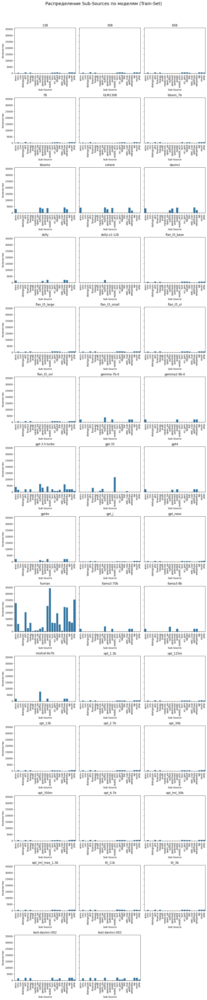

In [ ]:
dev_df = dataset["train"].to_pandas()

# Извлечь и отсортировать все модели и подисточники
all_models = sorted(dev_df["model"].unique())
all_sub_sources = sorted(dev_df["sub_source"].unique())

# Определить Layout на 5 столбцов
n_models = len(all_models)
n_cols = 3
n_rows = (n_models + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(4*n_cols, 4*n_rows), sharey=True)
axes = axes.flatten()

for idx, model in enumerate(all_models):
    ax = axes[idx]
    subset = dev_df[dev_df["model"] == model]
    sns.countplot(
        data=subset,
        x="sub_source",
        order=all_sub_sources,
        ax=ax
    )
    ax.set_title(model)
    ax.set_xlabel("Sub-Source")
    ax.set_ylabel("Количество")
    ax.tick_params(axis='x', rotation=90)

# Скрыть пустые оси, если моделей меньше, чем подграфиков
for j in range(idx + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.suptitle("Распределение Sub-Sources по моделям (Train-Set)", fontsize=18, y=1.02)
plt.show()

# Часть 1: Эксперимент -1 с моделью для стиринг векторов будет - ***llama-2-7b-hf***. Этой модели нет в выборке. Как уже указано выше начальный домен исследования будет reddit. Модели для тренировочного датасета будут ***gpt-3.5-turbo***, ***gpt4***, ***llama3-70b***. Для тестовой выбоки и последующего вычесления проекций воспользуюсь текстами от ***mixtral-8x7b***, ***gpt4o***  и ***gemma2-9b-it***.

In [ ]:
models_of_interest = {"train": ["human", "gpt-3.5-turbo", "gpt4", "llama3-70b"],
                      "dev": ["human", "mixtral-8x7b", "gpt4o", "gemma2-9b-it"]}
sources_of_interest = {"train": ["reddit"],
                       "dev": ["reddit"]} #"wikipedia", "finance", "outfox", "yelp"

splits = {"train": None, "dev": None}

for split in splits:
    splits[split] = dataset[split].filter(
        lambda sample: sample["model"] in models_of_interest[split] and sample["sub_source"] in sources_of_interest[split]
    )
    df = splits[split].to_pandas()
    sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
    splits[split] = datasets.Dataset.from_pandas(sampled_df)

C:\Users\DarMan\AppData\Local\Temp\ipykernel_8256\3471627418.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
C:\Users\DarMan\AppData\Local\Temp\ipykernel_8256\3471627418.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42

In [ ]:
splits

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 28774
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 11306
 })}

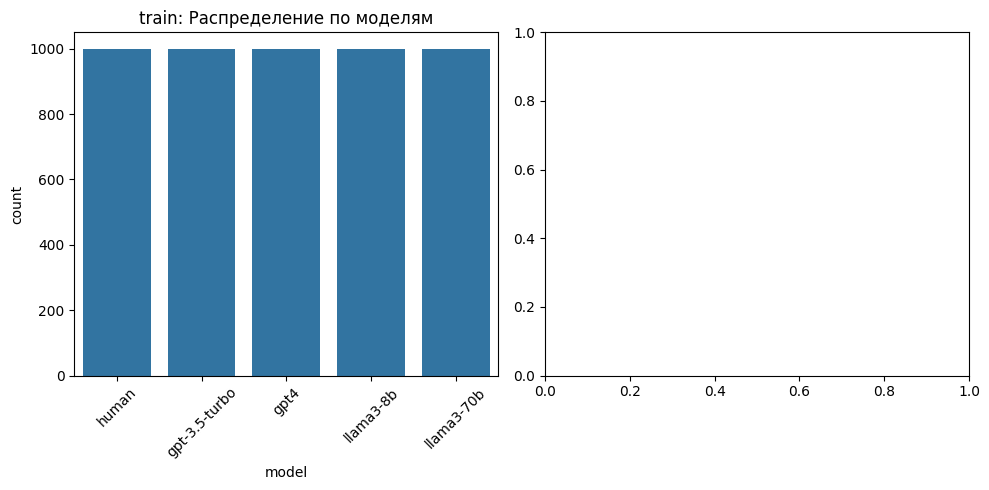

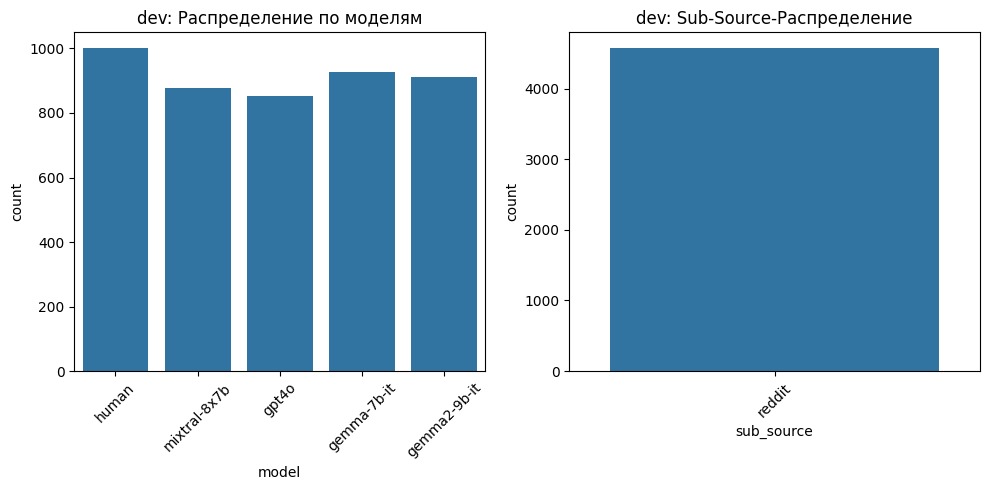

In [ ]:
def plot_distribution(df, split_name):
    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    sns.countplot(data=df, x="model", order=models_of_interest[split_name])
    plt.title(f"{split_name}: Распределение по моделям")
    plt.xticks(rotation=45)

    plt.subplot(1, 2, 2)
    if split_name == "dev":
        sns.countplot(data=df, x="sub_source", order=sources_of_interest["dev"])
        plt.title(f"{split_name}: Sub-Source-Распределение")
        plt.xticks(rotation=45)

    plt.tight_layout()
    plt.show()

plot_distribution(splits["train"].to_pandas(), "train")
plot_distribution(splits["dev"].to_pandas(), "dev")


## Закрузка llama-2-7b-hf.

In [ ]:
def get_model_and_tokenizer(model_name: str):
    tokenizer = AutoTokenizer.from_pretrained(model_name)
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.float16)
    return model, tokenizer

In [ ]:
model_size = "7b"
model_name = f"meta-llama/Llama-2-{model_size}-hf"
model, tokenizer = get_model_and_tokenizer(model_name)

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

## По структуру модели llama-2-7b-hf видно, что словарь состовляет 32000 и основная часть модели это decoder block, который состоит из 32 слоев.

In [ ]:
print(model)

LlamaForCausalLM(
  (model): LlamaModel(
    (embed_tokens): Embedding(32000, 4096)
    (layers): ModuleList(
      (0-31): 32 x LlamaDecoderLayer(
        (self_attn): LlamaAttention(
          (q_proj): Linear(in_features=4096, out_features=4096, bias=False)
          (k_proj): Linear(in_features=4096, out_features=4096, bias=False)
          (v_proj): Linear(in_features=4096, out_features=4096, bias=False)
          (o_proj): Linear(in_features=4096, out_features=4096, bias=False)
        )
        (mlp): LlamaMLP(
          (gate_proj): Linear(in_features=4096, out_features=11008, bias=False)
          (up_proj): Linear(in_features=4096, out_features=11008, bias=False)
          (down_proj): Linear(in_features=11008, out_features=4096, bias=False)
          (act_fn): SiLU()
        )
        (input_layernorm): LlamaRMSNorm((4096,), eps=1e-05)
        (post_attention_layernorm): LlamaRMSNorm((4096,), eps=1e-05)
      )
    )
    (norm): LlamaRMSNorm((4096,), eps=1e-05)
    (rotary_e

## Как я уже указала выше, для подсчета стириг векторов я написала несколько функций, которые объединяются в пайплин calculate_steering_vector(). Он использует в себе следующие финкции:
    - collect_acrivations() пропускаут через себя каждый текст выборки - тренировочной и тестовой, и аккумилирует функции активаций.
    - calculate_steering_from_activations() считает стиринг векторы "фековости" для каждого слоя модели.
    - extraxt_and_organize_data() собирает данные с лейблами 0 (реальные) и 1 (фейковый).
    - calculate_steering_vector() считает стиринг векторы.
Параметор *only_dev* регулирует возможность посчитать активации только на тестовом домене: это релевантно для последующего переноса домена, где steering вектор считаеться на одном множестве, а тестить будем на другом. В моем случае я ужуж раз вызову эту функцию с параметром *only_dev=True*, чтобы посчитаь активации только на тестовом домене.

In [ ]:
results = calculate_steering_vector(
        model=model,
        tokenizer=tokenizer,
        datasets=splits,
        save_dir="../computed_steering_data/llama_steering_vectors3",
        max_length=256,
        real_label=0,  # Label für echte Texte
        fake_label=1,   # Label für falsche Texte
        only_dev=False,
        device = device
    )

print("Steering vector calculation completed!")
print(f"Overall steering vector shape: {results['steering_vectors']['overall'].shape}")

# Zusätzliche Analyse
print("\nDetailed results:")
for key, value in results['metadata'].items():
    print(f"{key}: {value}")

INFO:__main__:Starting steering vector calculation on cuda:0
INFO:__main__:Train data: 20353 real, 8421 fake texts
INFO:__main__:Dev data: 8663 real, 2643 fake texts


train: 20353 real texts, 8421 fake texts
dev: 8663 real texts, 2643 fake texts


Processing data splits:   0%|          | 0/2 [00:00<?, ?it/s]INFO:__main__:Processing train data...
INFO:__main__:Processing 20353 real texts from train
Processing texts: 100%|██████████| 20353/20353 [14:31<00:00, 23.36it/s]
INFO:__main__:Saving activations to llama_steering_vectors3\train_real_activations.pkl
INFO:__main__:Processing 8421 fake texts from train
Processing texts: 100%|██████████| 8421/8421 [06:02<00:00, 23.21it/s]
INFO:__main__:Saving activations to llama_steering_vectors3\train_fake_activations.pkl
Processing data splits:  50%|█████     | 1/2 [20:42<20:42, 1242.45s/it]INFO:__main__:Processing dev data...
INFO:__main__:Processing 8663 real texts from dev
Processing texts: 100%|██████████| 8663/8663 [06:17<00:00, 22.94it/s]
INFO:__main__:Saving activations to llama_steering_vectors3\dev_real_activations.pkl
INFO:__main__:Processing 2643 fake texts from dev
Processing texts: 100%|██████████| 2643/2643 [01:55<00:00, 22.86it/s]
INFO:__main__:Saving activations to llama_stee

Steering vector calculation completed!
Overall steering vector shape: torch.Size([4096])

Detailed results:
train_real_count: 20353
train_fake_count: 8421
dev_real_count: 8663
dev_fake_count: 2643
max_length: 256
layer_type: decoder_block
device: cuda:0
real_label: 0
fake_label: 1


# Визуализация полученных steering векторов и активаций. Функции и их подродное описание можно найти в модуле "visualize_computed_steering_vectors". На графиках ниже создам магнитуду веторов, косинусное подобие от слоя а слою, heat-Map усредненного стиринг вектора, а тaкже T-SNE, PCA и UMAP каждого слоя относительно меток. По каждому слою построю график дисперсии классов.

Loading results...
Loaded 4 activation sets


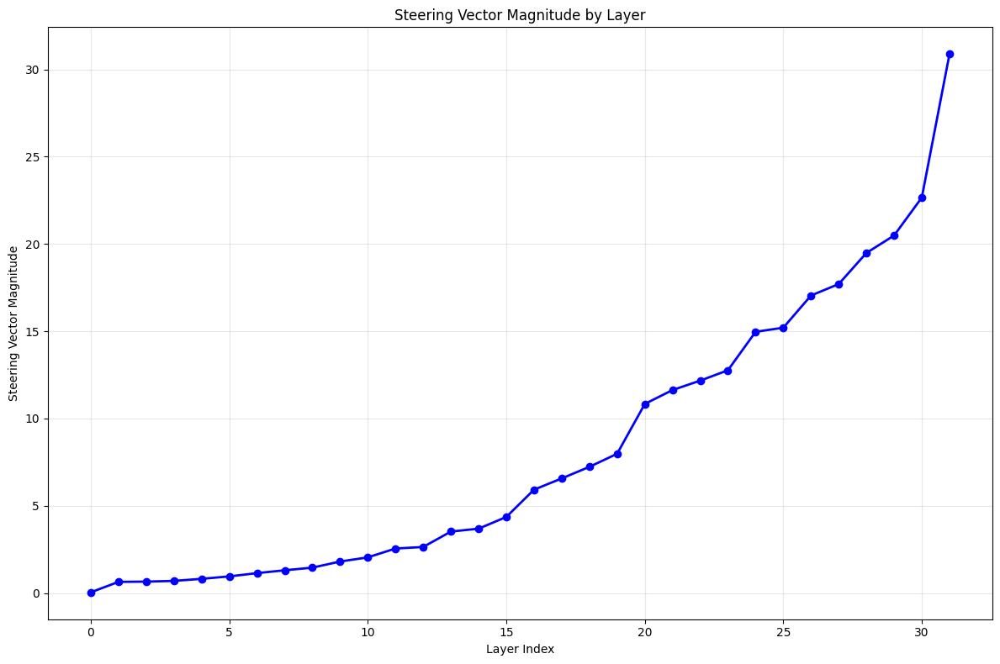

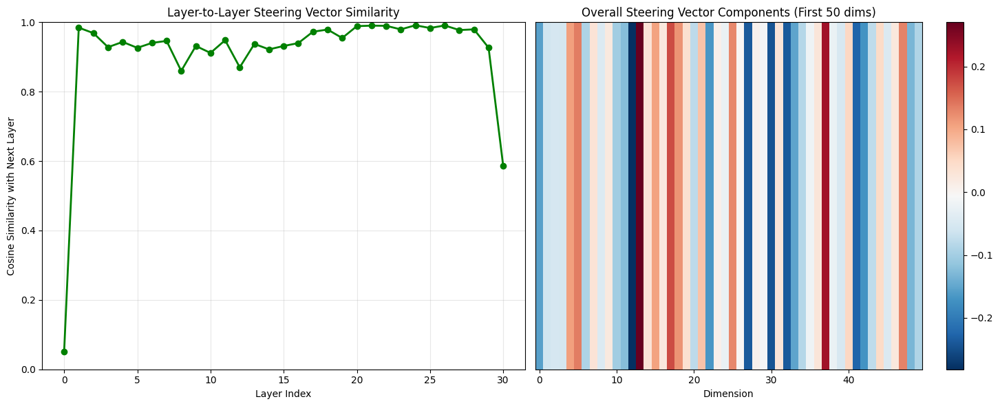

c:\Users\DarMan\stepik\Projekt_2Sem_DLS\Projekt\notebooks\..\visualize_computed_steering_vectors\visualisation_funktion.py:151: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(2, 2, figsize=(16, 12))


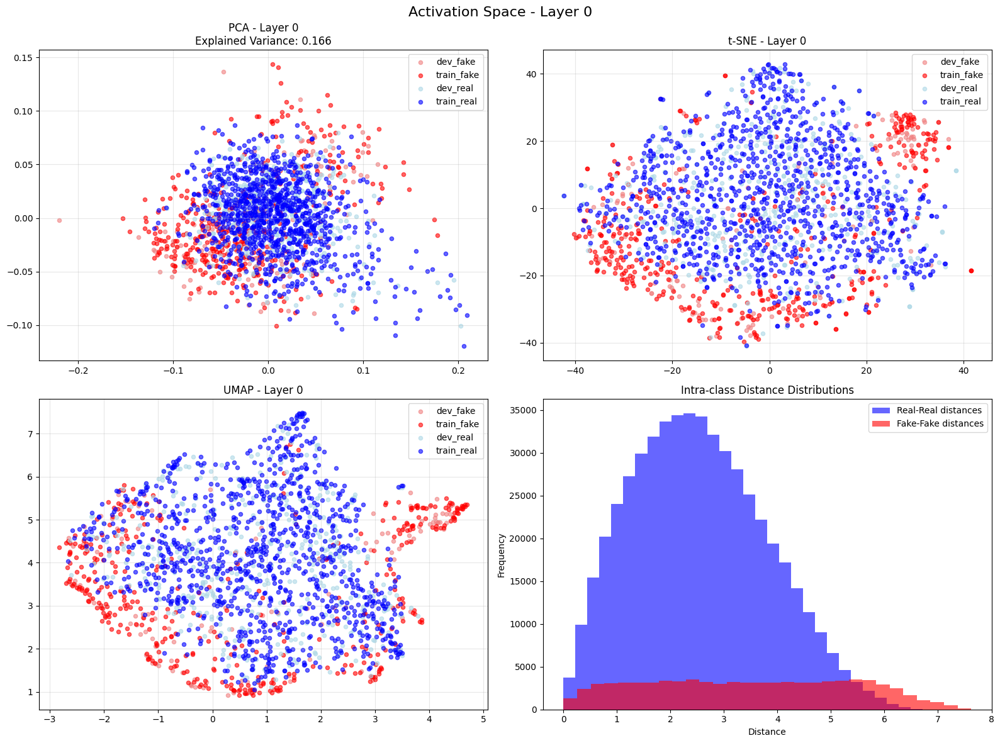

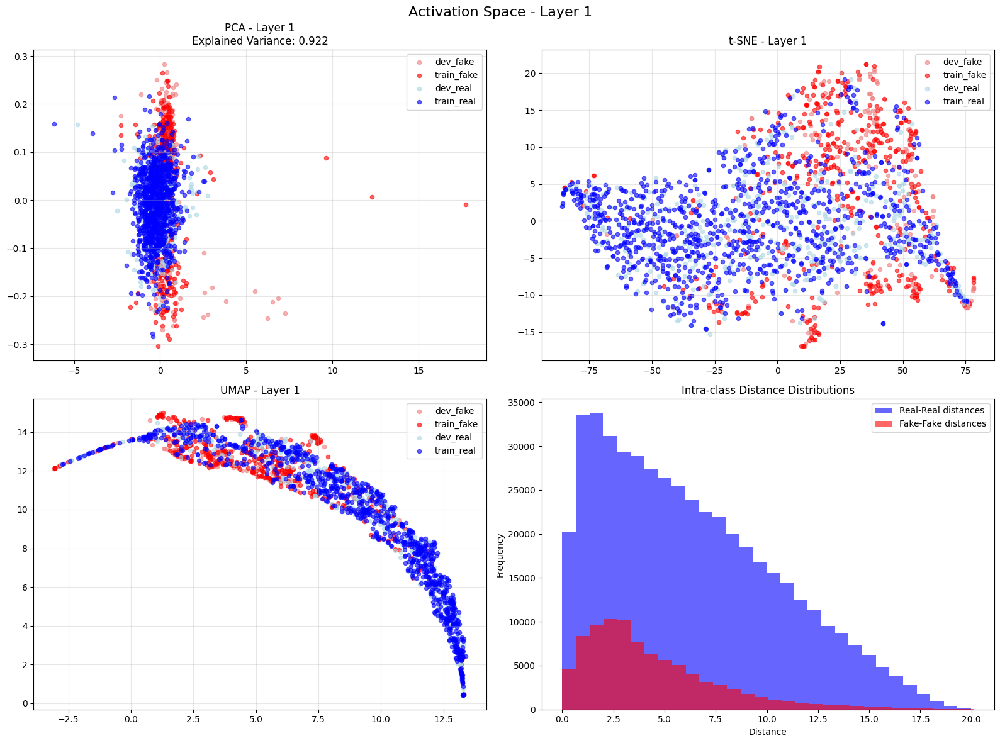

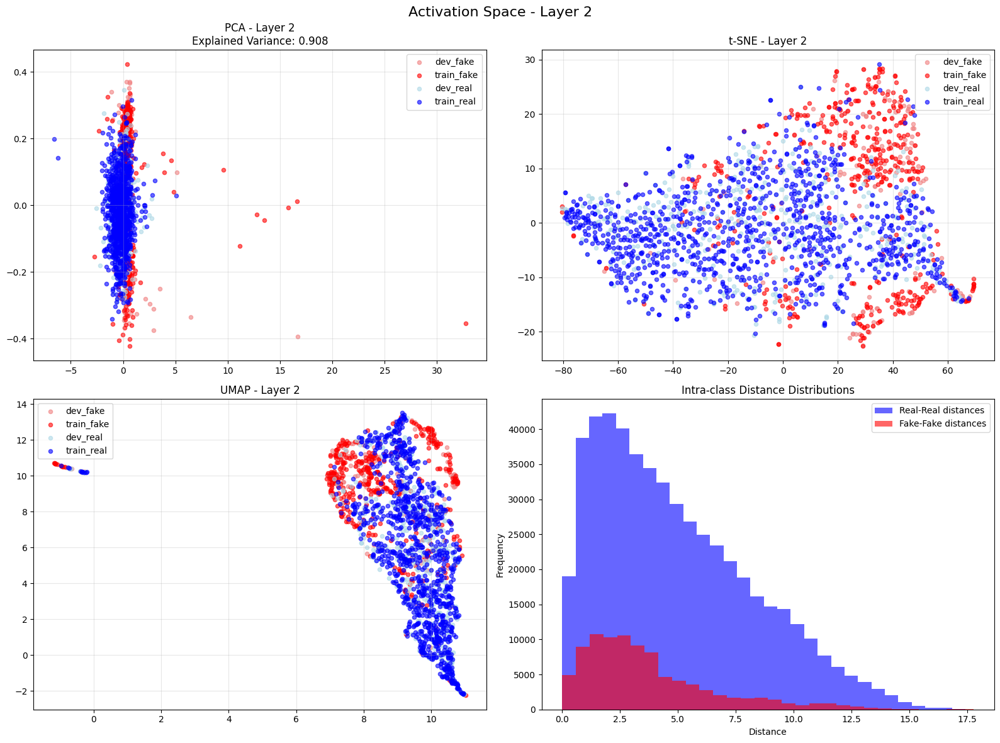

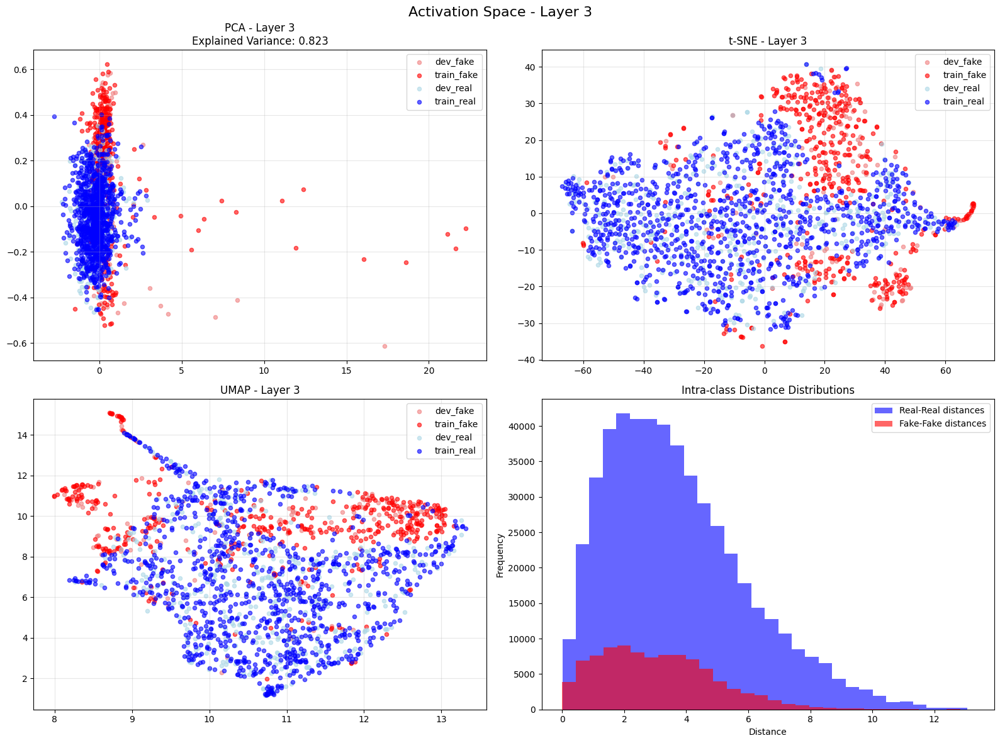

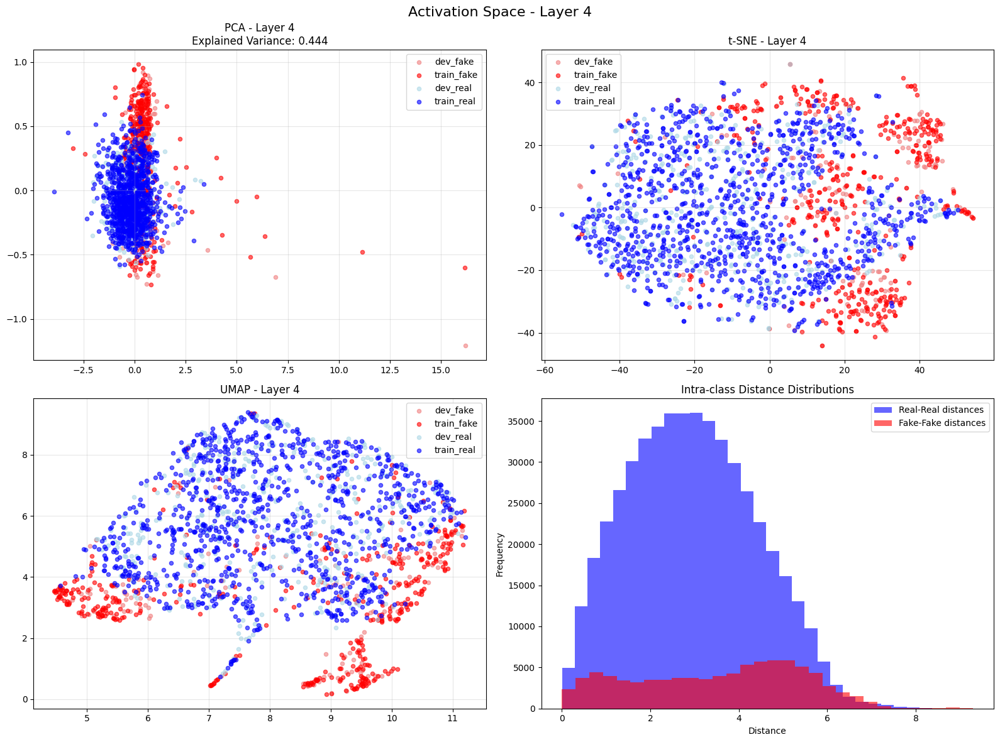

...

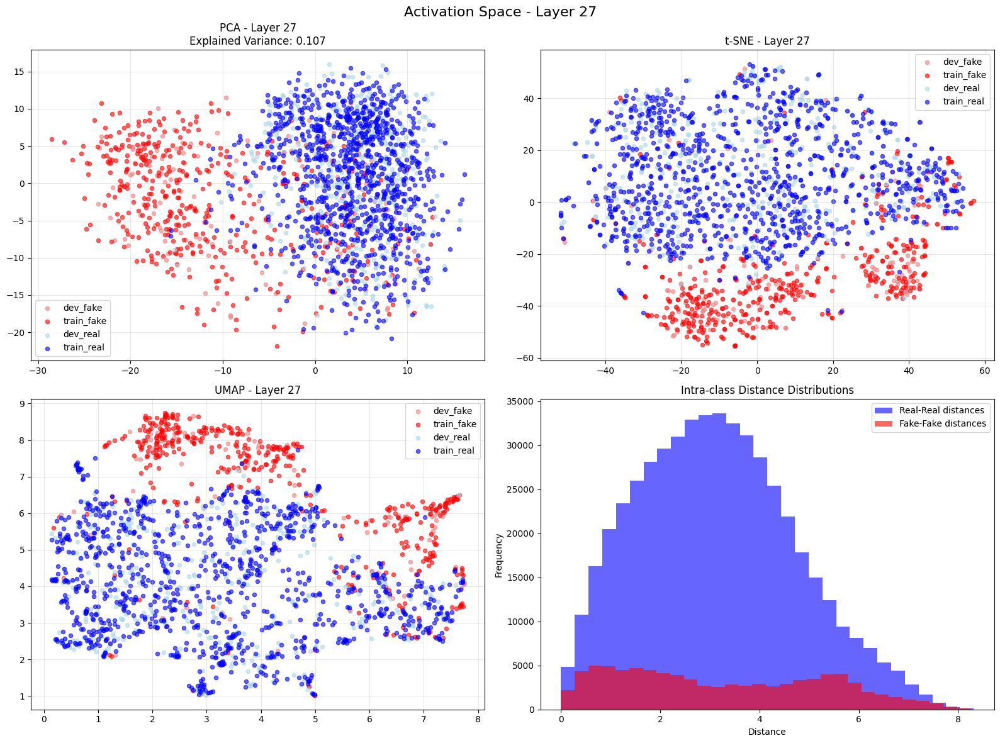

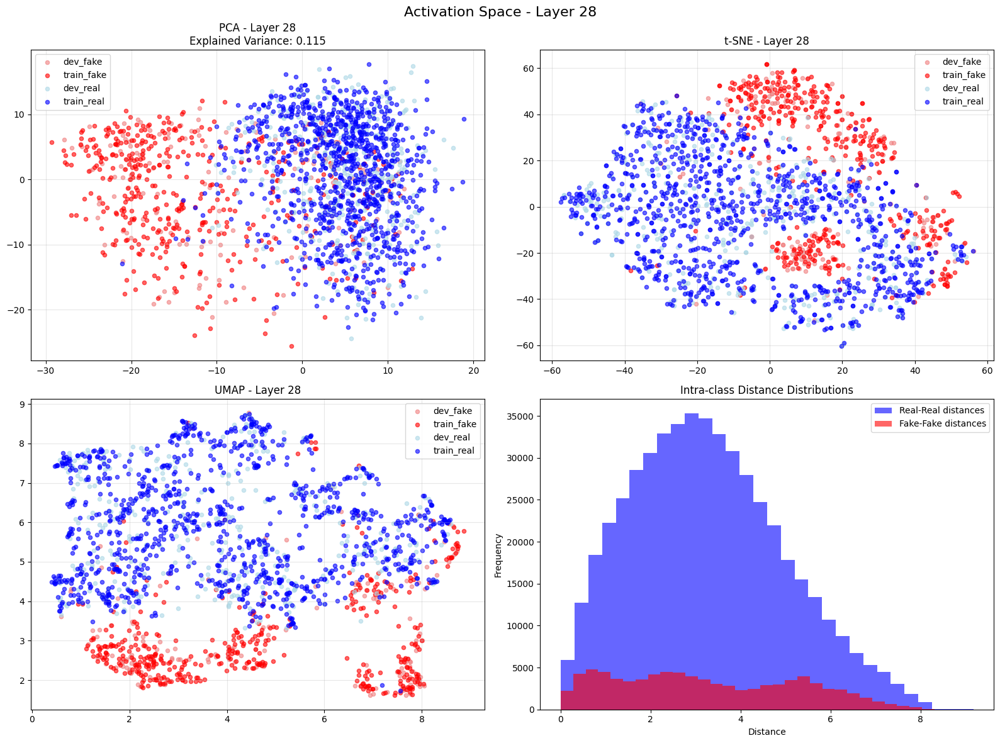

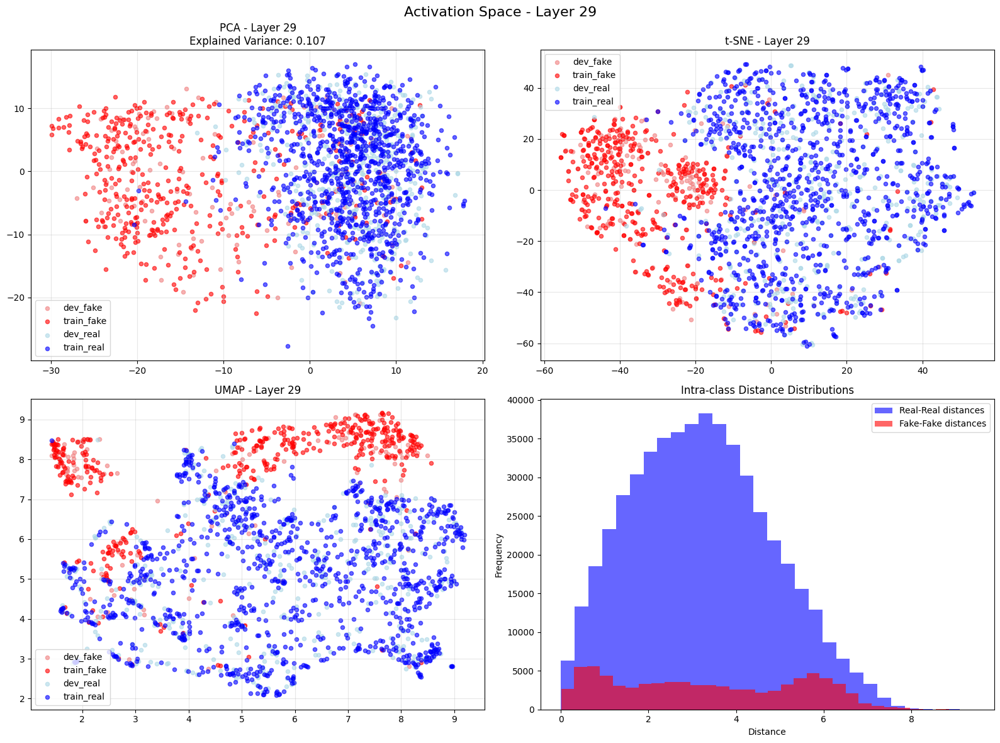

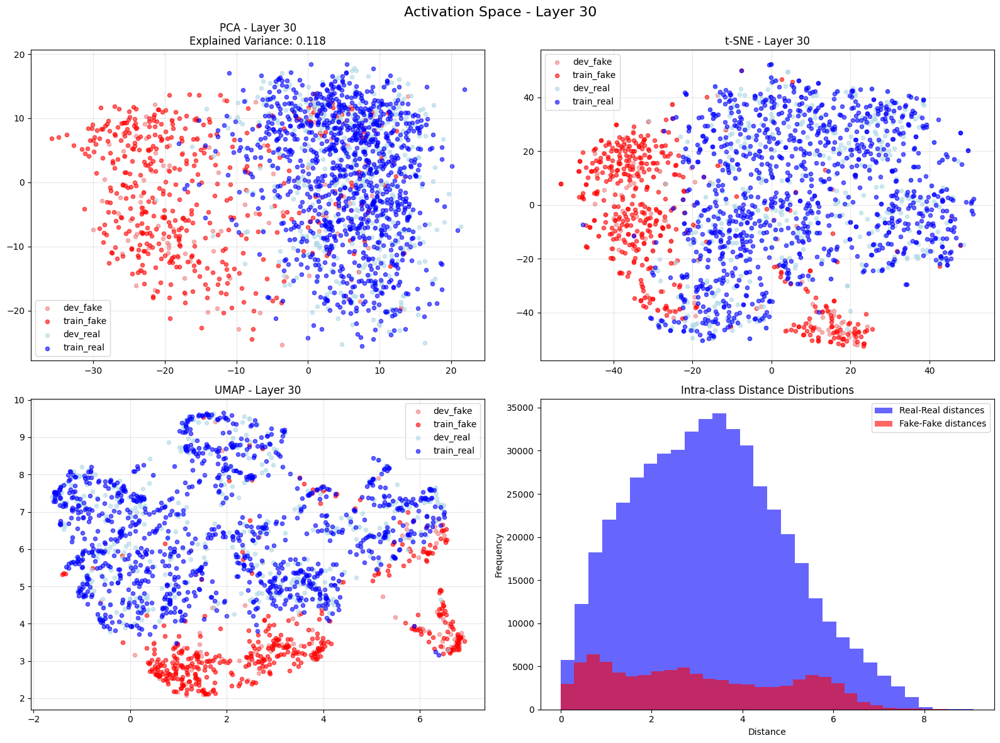

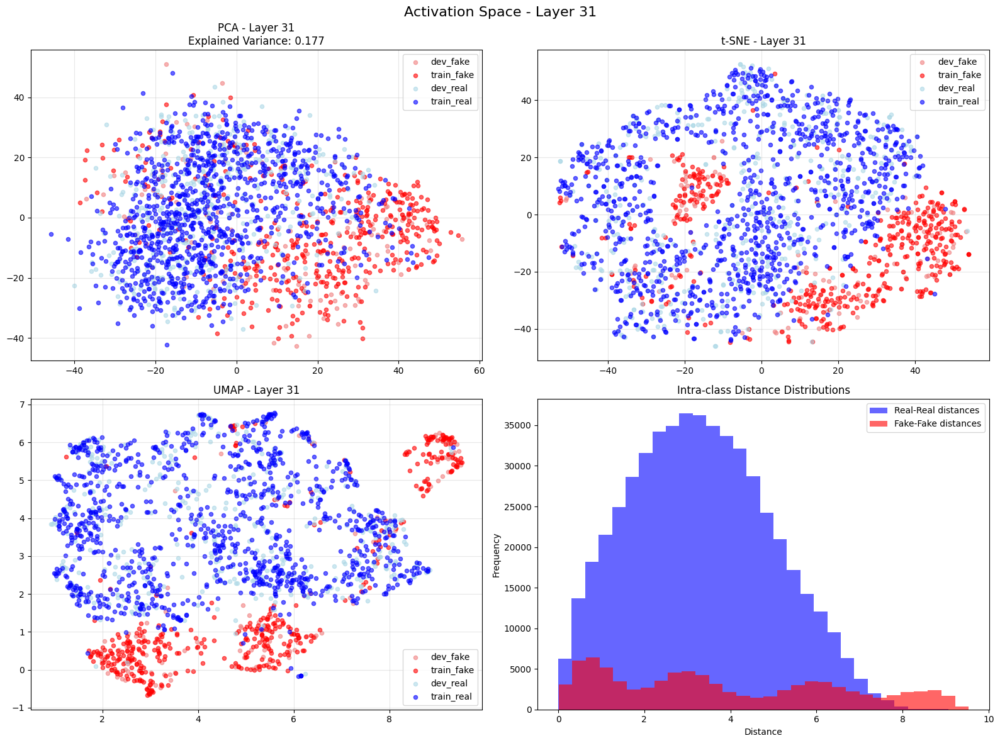

Computed activation space for all 32 layers
Creating combined visualization for 32 layers
Saved combined visualization for PCA to ../visualized_data_from_steering_vectors/steering_visualizations3\activation_space_all_layers_pca.png


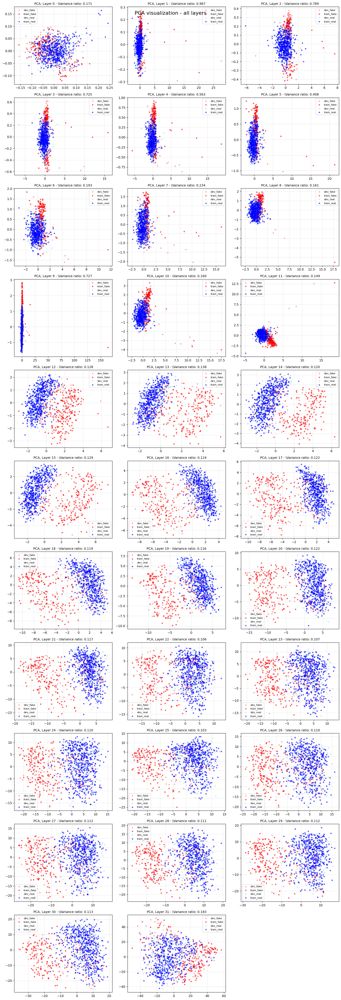

Saved combined visualization for t-SNE to ../visualized_data_from_steering_vectors/steering_visualizations3\activation_space_all_layers_t-sne.png


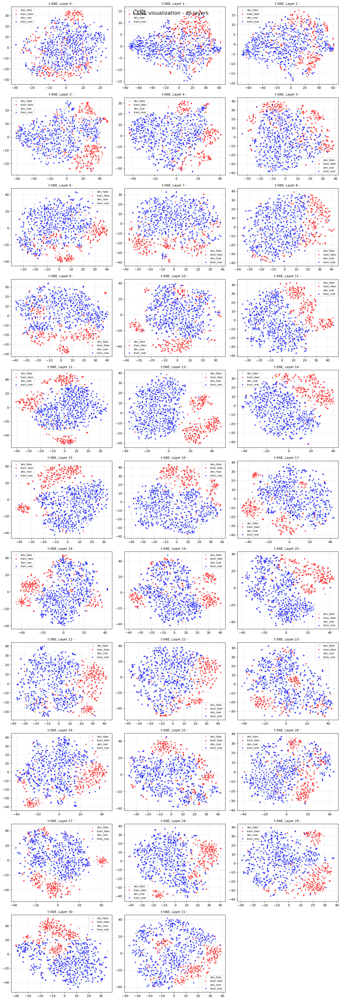

Saved combined visualization for UMAP to ../visualized_data_from_steering_vectors/steering_visualizations3\activation_space_all_layers_umap.png


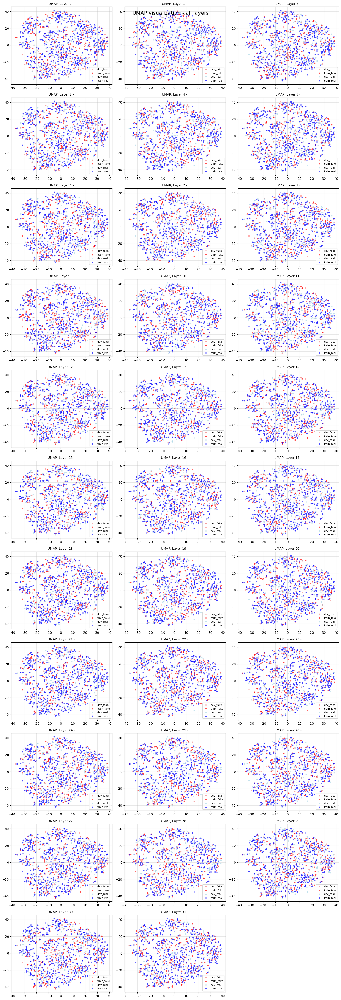

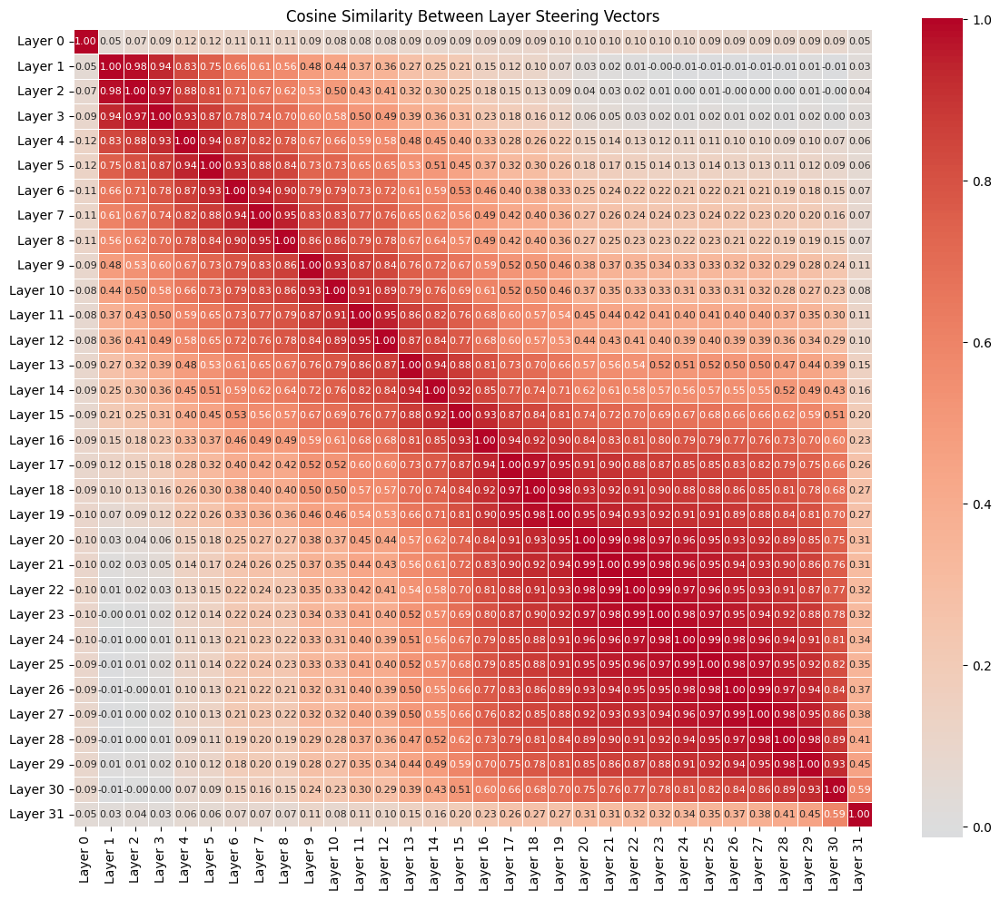

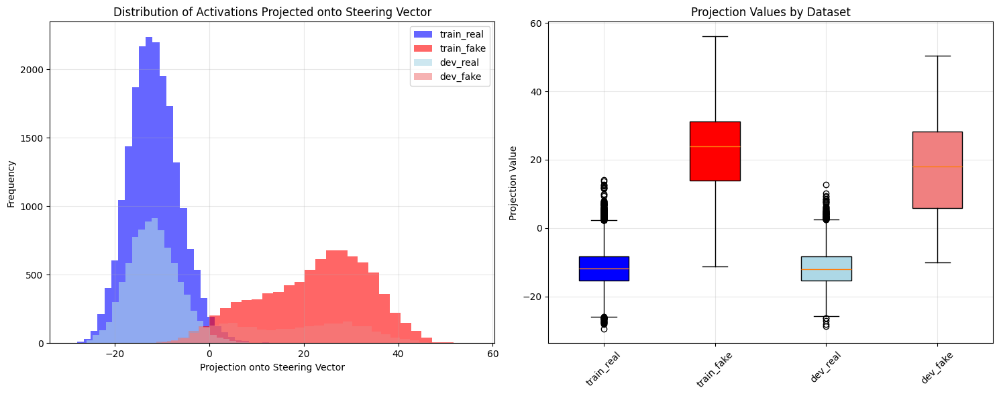


Projection Statistics:
train_real: Mean=-11.6719, Std=inf
train_fake: Mean=22.2812, Std=inf
dev_real: Mean=-11.7266, Std=inf
dev_fake: Mean=17.3906, Std=inf
Visualization completed! Plots saved to: ../visualized_data_from_steering_vectors/steering_visualizations3


c:\Users\DarMan\stepik\Projekt_2Sem_DLS\.venv\Lib\site-packages\numpy\_core\_methods.py:171: RuntimeWarning: overflow encountered in reduce
  arrmean = umr_sum(arr, axis, dtype, keepdims=True, where=where)
c:\Users\DarMan\stepik\Projekt_2Sem_DLS\.venv\Lib\site-packages\numpy\_core\_methods.py:205: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(x, axis, dtype, out, keepdims=keepdims, where=where)


In [ ]:
visualize_steering_vectors(
        target_dtype=torch.float16, # тип векторов модели по данным с HuggingFace
        results_path="../computed_steering_data/llama_steering_vectors3/complete_results.pkl",
        save_plots=True,
        plot_dir="../visualized_data_from_steering_vectors/steering_visualizations3")

In [ ]:
# import shutil
# #from google.colab import files
# #shutil.make_archive('/content/llama_steering_vectors_backup', 'zip', '/content/llama_steering_vectors')
# #files.download('/content/llama_steering_vectors_backup.zip')
# shutil.make_archive('llama_steering_vectors3', 'zip', 'llama_steering_vectors3')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\llama_steering_vectors3.zip'

## Выводы по первой части:
- график магнитуды показывает "длину" и "силу" стиринг вектора в конкретном слое. Согласно статье Steering Vector Magnitude Analisys (https://arxiv.org/abs/2707.12404), большие магнитуды в определенных слоях могут указывать на то, что эти слои более активно реагируют на тестируемый концепт - в моем случае на концепт "фейковости". По скачку между 13 и 14 слоями понятно, что в 13 слое появилась новая информации относительно темстируемого концепта. Это же подтверждает график Cosine Similarity Between Layer Steering Vectors: 13 слой положительно коррелирует со всеми последующими слоями.Это и неудивительно, ведь появившаюся информация о фейковости в 13 слое линейрно прибавлятся в каждому последующему слою.
- Однако нельза с уверенность сказать, что именно 13 слой отвечает за фейковость. Также виден сильный скачек магнитуды в 18, 22 и 29 слоях. Это может быть связано с тем, что в этих слоях добавляется "новая информация" относительно фейковости.
- Интерсная картина складывается на графиках PCA, TSNE и UMAP. PCA явно удается, начиная с 13 слоя, поделить множесто векторов на две группы. С UMAP все графики получилисьне с таким более менее четким распределением. TSNE, наоборот, показывает - снова начиная с 13 слою - определенную кластиризацию, хоть и не так четко, как хотелось бы.
- График Layer-to-Layer Similarity показывает, насколько стиринг векторы похожи между соседними слоями. Видно, что самый первый слой сильно отличается от последующего. Далее сильно бросатеся в глаза провалы между 11, 12 и 13 слоями, а также между 31 и 32. Высокое сходство между слоями или очень гладкая линия  показывала бы, что концепт "фейковости" обрабатыватся всеми слоями павно и каждый слой привносит примерно одинаковую информацию. Низкое сходство между слоями, что должны показывать сильные провалы на графике, означают, где происподит перестойка концепта. Упомянутые слои - 11, 12 и 13, 31 и 32 - явно относятся ко второй части.
- Heatmap усредненного стиринг вектора показывает, что для концепта "фейковости" для модели llama-2-7b-hf необходима сметь из слоев с более положительной информацией (красные полосы) и в тоже время с слоями с сильно подавленными значениями (синие полосы). Нейтральных полос довольно мало.

# Часть 2: Вычисление проекций и тренировка полученных результатов на трех классификаторах (логистической регрессии, random forest, SVM)

### Для этой части исследования я написала функции. Они получились довольно объемными, и для читабельности я вынесла их, также как и предыдущие функции, в отдельные файл "projection_and_ml_train_function.py" в папке "compute_projection".
    - load_steering_data: загружает раннее созданные данные
    - claculate_projections: вычисляет проекции
    - evaluate_all_layers: оценивает каждый классификатор по отдельности на всех слоях. Использует в себе функции create_classifikation_dataset(), calculate_correlation() и train_classifier().
    - plot_layer_performance(): рисует графики оценки обцчения по каждому слою и выводит топовые значения.

In [ ]:
sys.path.append('..') # Путь к папке с модулем compute_projection
from compute_projection import load_steering_data, calculate_projections, evaluate_all_layers, plot_layer_performance

Lade Trainingsdaten aus llama_steering_vectors3
Lade Entwicklungsdaten aus llama_steering_vectors3
TRAIN-DATA: 20353 real, 8421 fake Samples
DEV-DATA: 8663 real, 2643 fake Samples
Berechne Projektionen für Trainings- und Entwicklungsdaten...
Verarbeite 32 Layer-Steering-Vektoren
Trainingsprojektionen und Entwicklungsprojektionen gespeichert in steering_vectors_dotProduct3\projections
Evaluating all layers (train & dev)...
Combined results saved to steering_vectors_dotProduct3\layer_evaluation_results.csv
Best model: Logistic Regression (0.9583)


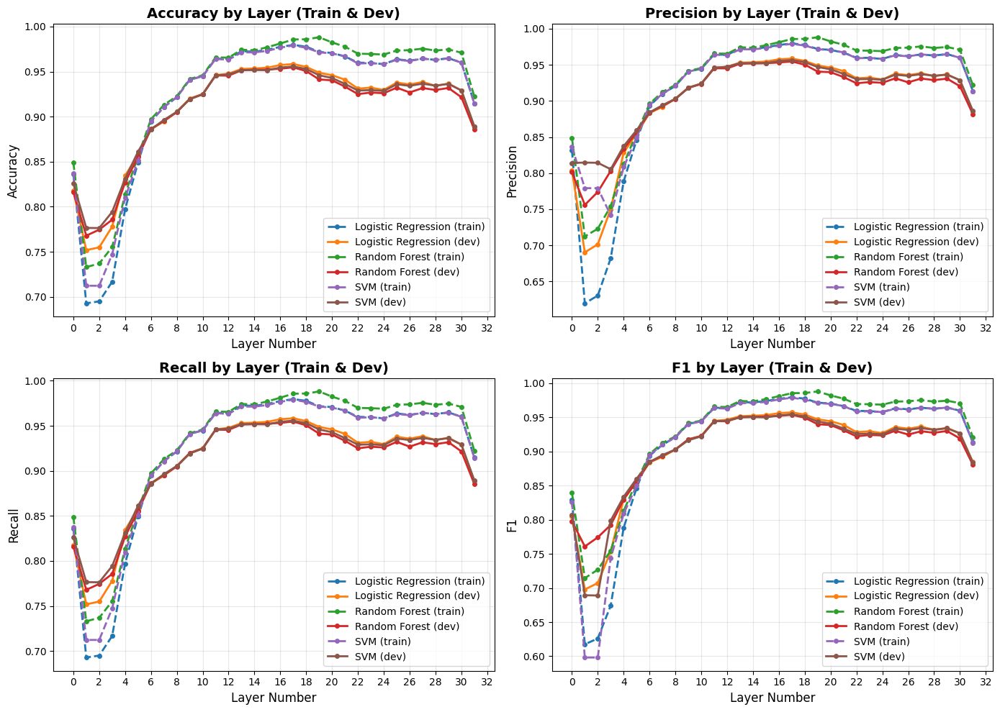

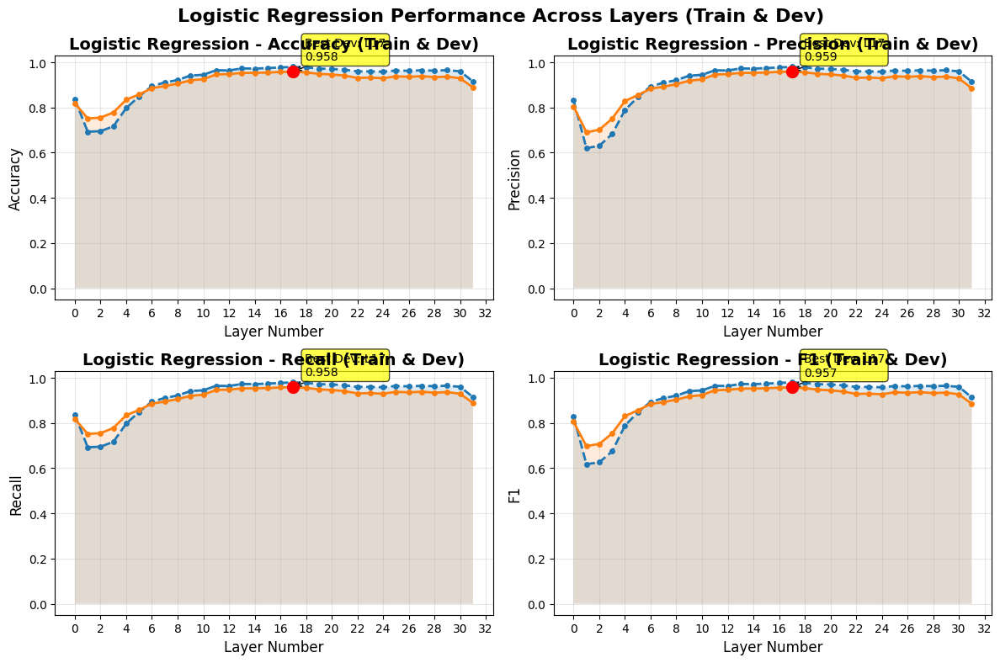

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

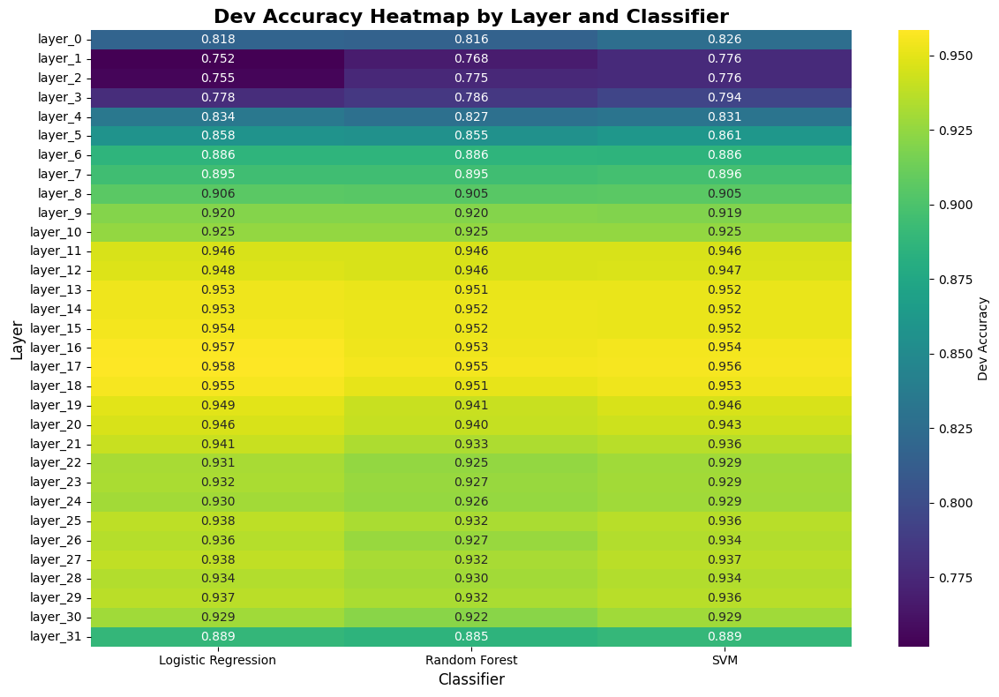

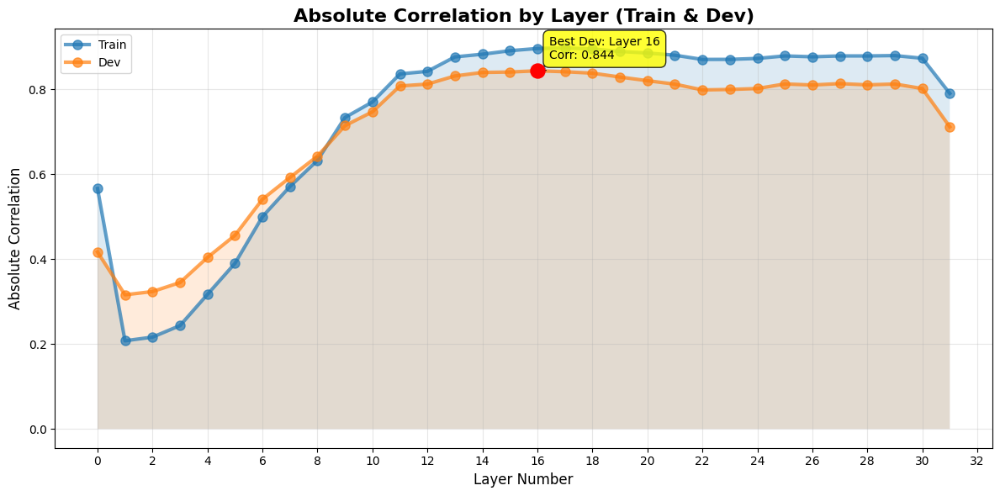

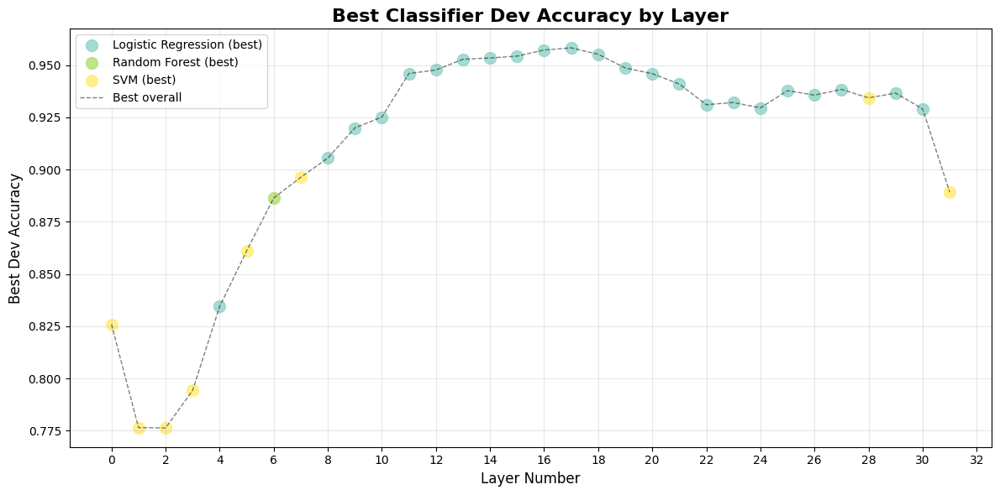

All plots saved to ./steering_vectors_dotProduct\plots

=== BEST LAYERS PER CLASSIFIER (Dev) ===
Logistic Regression: layer_17 (Dev Accuracy: 0.9583)
Random Forest: layer_17 (Dev Accuracy: 0.9547)
SVM: layer_17 (Dev Accuracy: 0.9557)

=== SUMMARY ===
'Total layers evaluated: 32'
'Total train samples: 28774'
'Total dev samples: 11306'
'\nBest dev correlation: layer_16 (r=0.8437)'
'Best dev F1 score: layer_17 with Logistic Regression (F1=0.9574)'

Top 5 layers by dev accuracy:
('   layer          classifier  dev_accuracy   dev_f1  dev_abs_correlation\n'
 'layer_17 Logistic Regression      0.958341 0.957419             0.841404\n'
 'layer_16 Logistic Regression      0.957279 0.956294             0.843666\n'
 'layer_17                 SVM      0.955687 0.954436             0.841404\n'
 'layer_18 Logistic Regression      0.955245 0.954195             0.838036\n'
 'layer_17       Random Forest      0.954714 0.953822             0.841404')
'\nBest train F1 score: layer_19 with Random Forest (

In [ ]:
data_train, data_dev = load_steering_data(save_dir = "../computed_steering_data/llama_steering_vectors3") #/content/llama_steering_vectors2

# Calculate projections
layer_projections_train, layer_projections_dev = calculate_projections(data_train, data_dev, save_dir="../computed_projection_data/steering_vectors_dotProduct3")

# Evaluate all layers
results_df, classifier_dfs, best_model_info = evaluate_all_layers(layer_projections_train, layer_projections_dev, save_dir="../computed_projection_data/steering_vectors_dotProduct3")

# Create visualizations
plot_layer_performance(results_df)

print("\n=== SUMMARY ===")
pprint(f"Total layers evaluated: {len(results_df['layer'].unique())}")

# Number of samples per set
train_samples = data_train['metadata']['train_real_count'] + data_train['metadata']['train_fake_count']
dev_samples = data_dev['metadata']['dev_real_count'] + data_dev['metadata']['dev_fake_count']
pprint(f"Total train samples: {train_samples}")
pprint(f"Total dev samples: {dev_samples}")

# Best Correlation (Dev)
best_corr_layer = results_df.loc[results_df['dev_abs_correlation'].idxmax()]
pprint(f"\nBest dev correlation: {best_corr_layer['layer']} (r={best_corr_layer['dev_correlation']:.4f})")

# Best layer according to Dev-F1
best_f1_layer = results_df.loc[results_df['dev_f1'].idxmax()]
pprint(f"Best dev F1 score: {best_f1_layer['layer']} with {best_f1_layer['classifier']} (F1={best_f1_layer['dev_f1']:.4f})")

# Top 5 Layers nach Dev-Accuracy
print("\nTop 5 layers by dev accuracy:")
top_5 = results_df.nlargest(5, 'dev_accuracy')[['layer', 'classifier', 'dev_accuracy', 'dev_f1', 'dev_abs_correlation']]
pprint(top_5.to_string(index=False))

# Optional: Best training values
best_train_f1_layer = results_df.loc[results_df['train_f1'].idxmax()]
pprint(f"\nBest train F1 score: {best_train_f1_layer['layer']} with {best_train_f1_layer['classifier']} (F1={best_train_f1_layer['train_f1']:.4f})")

## Выводы из второй части:
- по графикам видно, что логистическая регрессия ведет себя на обеих множествах более стабильно, чем остальные классификаторы.
- также можно заметить, что стабилный результат детекции достигается на ~13 слое и остается таким и на последующих слоях.
- по графику Absolute Correlation by Layer хорошо видно, что начальные слои - с 0 до 9 - случайно коррелируют с метками.
- по графику Heatmap на тестовом множестве заметен вклад слоев с 13 по 20 в задачу детекции. Эти слои и создают такие высикое метрики. Последующие слои показывают метрики слабее: Это можно объяснить тем, что эти слои отвечают за другие концепты и представление тестируемой "фейковости" растворяется в этих слоях.
- классификаторы не переобучаются (тестовая часть не сильно отличается от тренировочной) по результатам на тестовой частию Это указывает, что они хорошо справляются с поставленной задачей.

1. BEST LAYERS PER CLASSIFIER (Dev):
    - Logistic Regression: layer_17 (Dev Accuracy: 0.9583)
    - Random Forest: layer_17 (Dev Accuracy: 0.9547)
    - SVM: layer_17 (Dev Accuracy: 0.9557)

2. Top 5 layers by dev accuracy:

    | layer |  classifier  | dev_accuracy |  dev_f1 |  dev_abs_correlation |
    |-------|--------------|--------------|---------|----------------------|
    |layer_17 | Logistic Regression |  0.958341 | 0.957419 |  0.841404|
    | layer_16 | Logistic Regression | 0.957279 | 0.956294 |0.843666 |
    | layer_17 | SVM  | 0.955687 | 0.954436 | 0.841404 |
    | layer_18 | Logistic Regression | 0.955245 | 0.954195 | 0.838036 |
    | layer_17 | Random Forest | 0.954714 | 0.953822 | 0.841404 |

    Best train F1 score: layer_19 with Random Forest (F1=0.9880)


In [ ]:
#import shutil
#from google.colab import files
#shutil.make_archive('/content/steering_vectors_dotProduct', 'zip', '/content/steering_vectors_dotProduct')
shutil.make_archive('steering_vectors_dotProduct3', 'zip', 'steering_vectors_dotProduct3')
#files.download('/content/steering_vectors_dotProduct.zip')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\steering_vectors_dotProduct3.zip'

# Часть 3: Эксперимент-2: перенос домена на тексты медицинского и финансового характера. Если брать по домену ***hc3***, то там будет примерно ~5,6 тыс. текстов из finance и ~1,7 текстов по медицине из тренировачного датасета.

## В этой часть мы будем переносить домен на тексты финансового характера.

In [ ]:
models_of_interest = {"train": ["human", "gpt-35"],
                      "dev": ["human", "gpt-35"]}
sources_of_interest = {"train": ["finance"],
                       "dev": ["finance"]}

splits_finance = {"train": None, "dev": None}

for split in splits_finance:
    splits_finance[split] = dataset[split].filter(
        lambda sample: sample["model"] in models_of_interest[split] and sample["sub_source"] in sources_of_interest[split]
    )
    df = splits_finance[split].to_pandas()
    sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
    splits_finance[split] = datasets.Dataset.from_pandas(sampled_df)

C:\Users\DarMan\AppData\Local\Temp\ipykernel_8256\2687197604.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
C:\Users\DarMan\AppData\Local\Temp\ipykernel_8256\2687197604.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42

In [ ]:
splits_finance

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 5768
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 2414
 })}

### Финансовый датасет буду использовать как тестовое множество, тренинг будет проходить на домене reddit.

In [ ]:
empty_train = Dataset.from_dict({k :[] for k in splits_finance['train'].features})
data_finance = {
    'train': empty_train,
    'dev': concatenate_datasets([splits_finance["train"], splits_finance["dev"]])
}
data_finance

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 0
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 8182
 })}

In [ ]:
results = calculate_steering_vector(
        model=model,
        tokenizer=tokenizer,
        datasets=data_finance,
        save_dir="../computed_steering_data/llama_steering_vectors_finance3",
        max_length=256,
        real_label=0,  # Label für echte Texte
        fake_label=1,   # Label für falsche Texte
        only_dev = True,
        device= device
    )

print("Steering vector calculation for the domain finance completed!")
# Zusätzliche Analyse
print("\nDetailed results:")
for key, value in results['metadata'].items():
    print(f"{key}: {value}")

INFO:__main__:Starting steering vector calculation on cuda:0
INFO:__main__:Train data: 0 real, 0 fake texts
INFO:__main__:Dev data: 3692 real, 4490 fake texts


train: 0 real texts, 0 fake texts
dev: 3692 real texts, 4490 fake texts


Processing data splits:   0%|          | 0/2 [00:00<?, ?it/s]INFO:__main__:Processing train data...
INFO:__main__:Processing 0 real texts from train
INFO:__main__:Loading existing activations from llama_steering_vectors_finance3\train_real_activations.pkl
INFO:__main__:Processing 0 fake texts from train
INFO:__main__:Loading existing activations from llama_steering_vectors_finance3\train_fake_activations.pkl
INFO:__main__:Processing dev data...
INFO:__main__:Processing 3692 real texts from dev
INFO:__main__:Loading existing activations from llama_steering_vectors_finance3\dev_real_activations.pkl
INFO:__main__:Processing 4490 fake texts from dev
INFO:__main__:Loading existing activations from llama_steering_vectors_finance3\dev_fake_activations.pkl
Processing data splits: 100%|██████████| 2/2 [00:00<00:00,  2.57it/s]
INFO:__main__:only_dev=True or no train split: Steering vectors are NOT calculated
INFO:__main__:Steering vector calculation completed!


Steering vector calculation for the domain finance completed!

Detailed results:
train_real_count: 0
train_fake_count: 0
dev_real_count: 3692
dev_fake_count: 4490
max_length: 256
layer_type: decoder_block
device: cuda:0
real_label: 0
fake_label: 1


In [ ]:
shutil.make_archive('llama_steering_vectors_finance3', 'zip', 'llama_steering_vectors_finance3')
#files.download('/content/steering_vectors_dotProduct.zip')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\llama_steering_vectors_finance3.zip'

## Тренировка как во первой части и создание визуализаций:

Lade Trainingsdaten aus llama_steering_vectors3
Lade Entwicklungsdaten aus llama_steering_vectors_finance3
TRAIN-DATA: 20353 real, 8421 fake Samples
DEV-DATA: 3692 real, 4490 fake Samples
Berechne Projektionen für Trainings- und Entwicklungsdaten...
Verarbeite 32 Layer-Steering-Vektoren
Trainingsprojektionen und Entwicklungsprojektionen gespeichert in steering_vectors_dotProduct_from_another_domain_finance3\projections
Evaluating all layers (train & dev)...
Combined results saved to steering_vectors_dotProduct_from_another_domain_finance3\layer_evaluation_results.csv
Best model: SVM (0.9889)


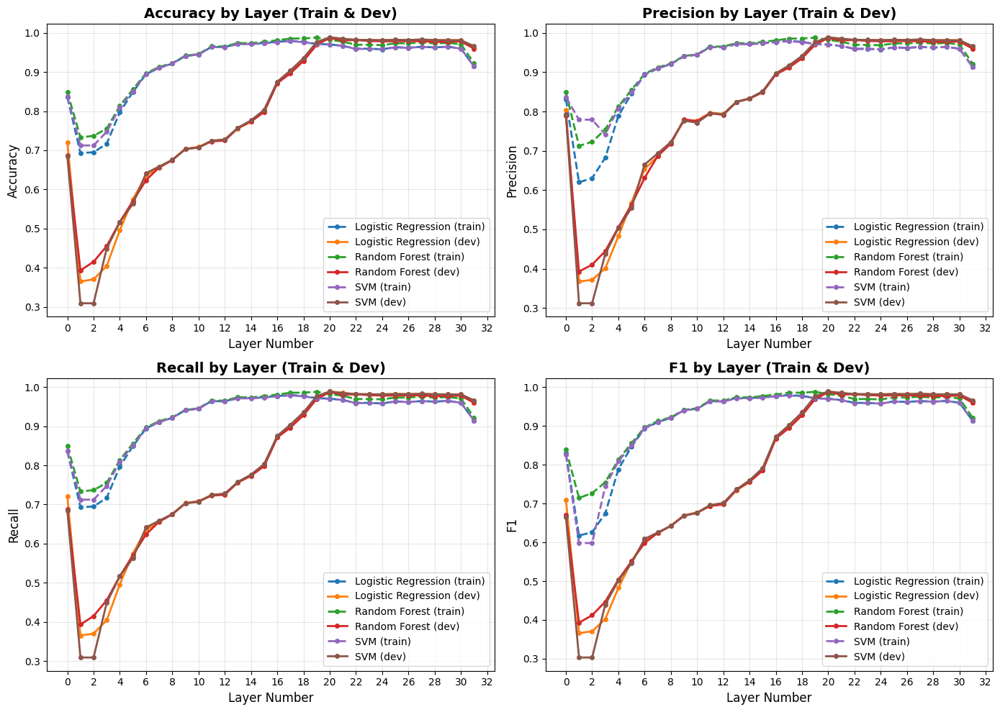

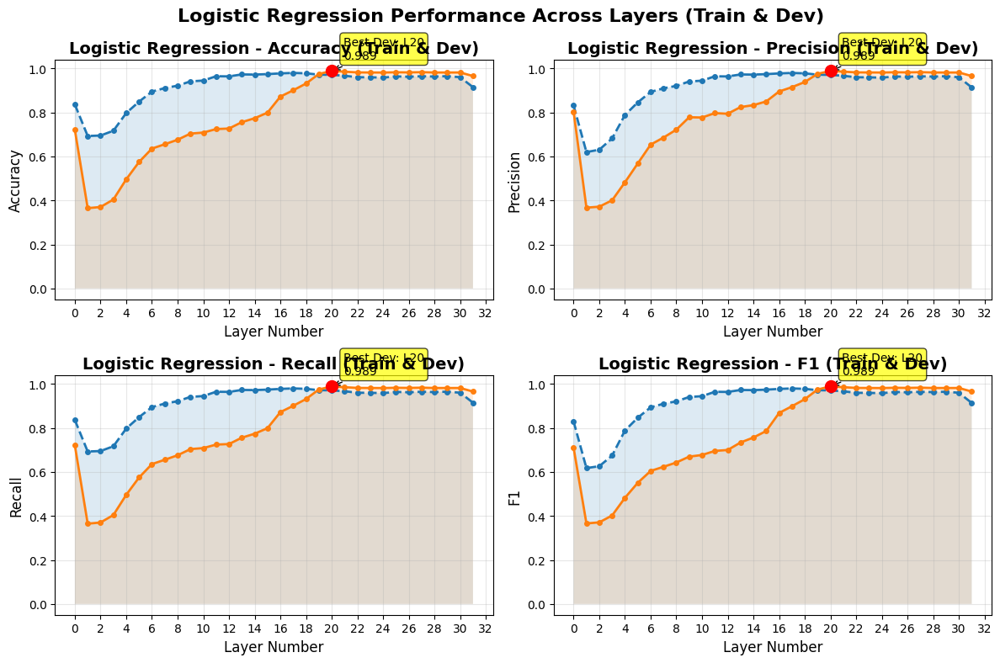

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

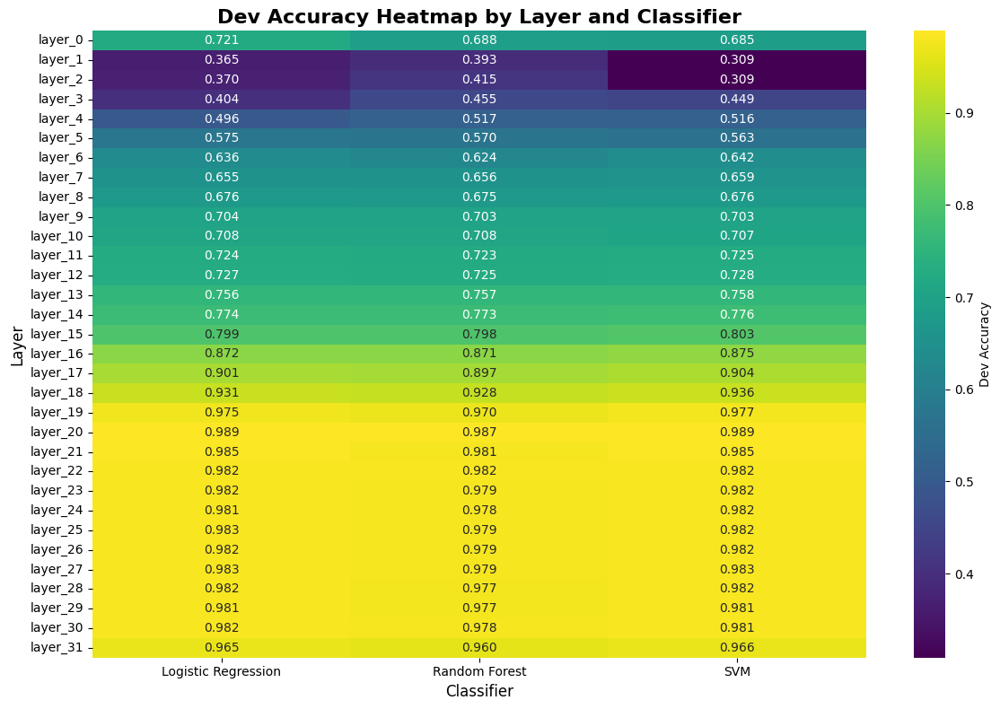

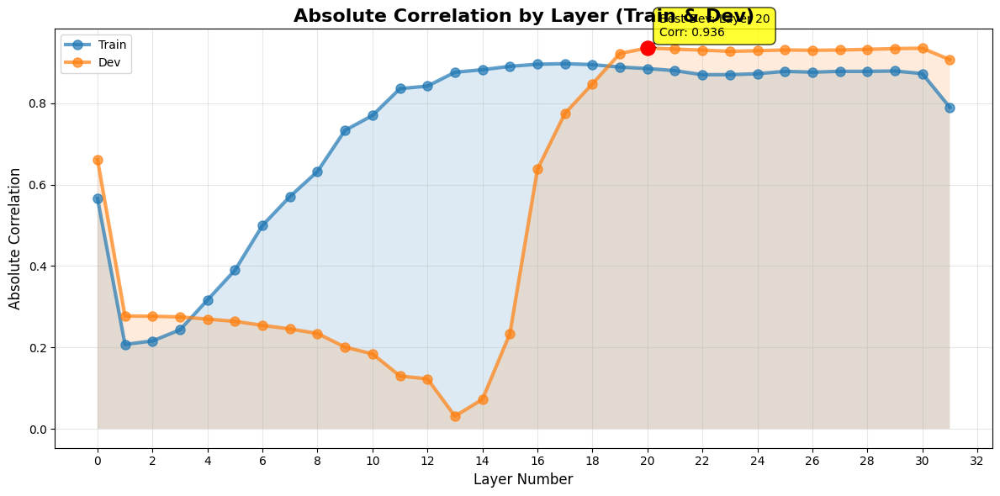

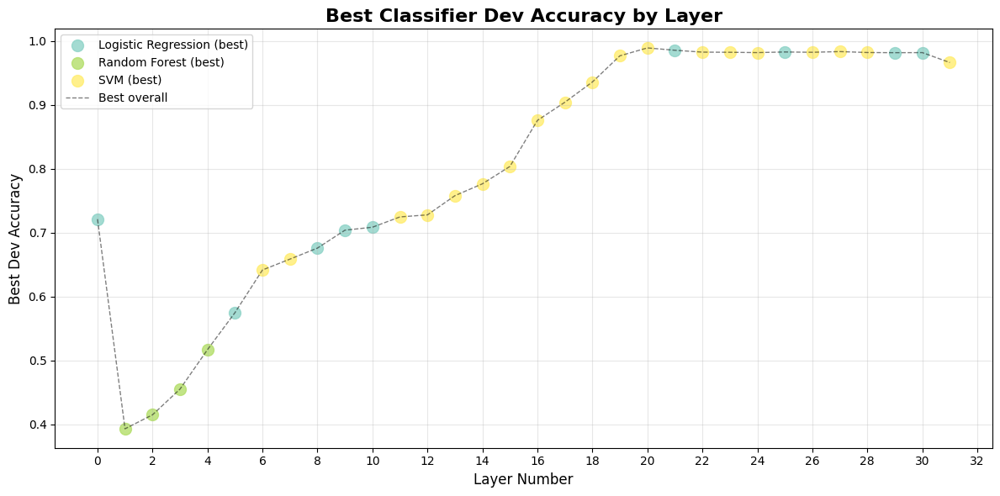

All plots saved to ./steering_vectors_dotProduct\plots

=== BEST LAYERS PER CLASSIFIER (Dev) ===
Logistic Regression: layer_20 (Dev Accuracy: 0.9886)
Random Forest: layer_20 (Dev Accuracy: 0.9872)
SVM: layer_20 (Dev Accuracy: 0.9889)

=== SUMMARY ===
'Total layers evaluated: 32'
'Total train samples: 28774'
'Total dev samples: 8182'
'\nBest dev correlation: layer_20 (r=0.9362)'
'Best dev F1 score: layer_20 with SVM (F1=0.9889)'

Top 5 layers by dev accuracy:
('   layer          classifier  dev_accuracy   dev_f1  dev_abs_correlation\n'
 'layer_20                 SVM      0.988878 0.988886             0.936216\n'
 'layer_20 Logistic Regression      0.988634 0.988641             0.936216\n'
 'layer_20       Random Forest      0.987167 0.987175             0.936216\n'
 'layer_21 Logistic Regression      0.985211 0.985225             0.933186\n'
 'layer_21                 SVM      0.984845 0.984860             0.933186')
'\nBest train F1 score: layer_19 with Random Forest (F1=0.9880)'


In [ ]:
data_train, data_dev_finance = load_steering_data(save_dir = "../computed_steering_data/llama_steering_vectors3", domain_tag = "from_another_domain", alt_dir = "../computed_steering_data/llama_steering_vectors_finance3")

# Calculate projections
layer_projections_train_finance, layer_projections_dev_finance  = calculate_projections(data_train, data_dev_finance, save_dir = "../computed_projection_data/steering_vectors_dotProduct_from_another_domain_finance3")

# Evaluate all layers
results_df, classifier_dfs, best_model_info = evaluate_all_layers(layer_projections_train_finance, layer_projections_dev_finance, save_dir = "../computed_projection_data/steering_vectors_dotProduct_from_another_domain_finance3")

# Create visualizations
plot_layer_performance(results_df)

# Print summary
print("\n=== SUMMARY ===")
pprint(f"Total layers evaluated: {len(results_df['layer'].unique())}")

# Number of samples per set
train_samples = data_train['metadata']['train_real_count'] + data_train['metadata']['train_fake_count']
dev_samples = data_dev_finance['metadata']['dev_real_count'] + data_dev_finance['metadata']['dev_fake_count']
pprint(f"Total train samples: {train_samples}")
pprint(f"Total dev samples: {dev_samples}")

#Best Correlation (Dev)
best_corr_layer = results_df.loc[results_df['dev_abs_correlation'].idxmax()]
pprint(f"\nBest dev correlation: {best_corr_layer['layer']} (r={best_corr_layer['dev_correlation']:.4f})")

# Best layer according to Dev-F1
best_f1_layer = results_df.loc[results_df['dev_f1'].idxmax()]
pprint(f"Best dev F1 score: {best_f1_layer['layer']} with {best_f1_layer['classifier']} (F1={best_f1_layer['dev_f1']:.4f})")

# Top 5 Layers nach Dev-Accuracy
print("\nTop 5 layers by dev accuracy:")
top_5 = results_df.nlargest(5, 'dev_accuracy')[['layer', 'classifier', 'dev_accuracy', 'dev_f1', 'dev_abs_correlation']]
pprint(top_5.to_string(index=False))

#Optional: Best training values
best_train_f1_layer = results_df.loc[results_df['train_f1'].idxmax()]
pprint(f"\nBest train F1 score: {best_train_f1_layer['layer']} with {best_train_f1_layer['classifier']} (F1={best_train_f1_layer['train_f1']:.4f})")

In [ ]:
shutil.make_archive('steering_vectors_dotProduct_from_another_domain_finance3', 'zip', 'steering_vectors_dotProduct_from_another_domain_finance3')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\steering_vectors_dotProduct_from_another_domain_finance3.zip'

## Выводы из третий части (перенос на финансовый):
- При переносе домена (from general to specific language) видно, что слои 13-20 уже не играют особой роли (по сравнению с первой частью). Они привносят свой маленький вклад в детекцию, но именно на 20 слое обучение стабилизируется: на всех графиках виден скачек.
- Интересная ситуация складывается на heatmap: слои 13-20, которые доминировали на обучении и тестировании одного домена, при переносе на другой домен ведут себя по другому - они выделяют фейковость, но не так явно. Осовной вклад в метрики происходит на последующих слоях.
- Можно предположить, что сам концепт "фейковости" не однороден и состоит из подконцептов, которые специфичны для каждого домена. В этом случае понятно поведение классификаторов: при переносе домена осталась только общая "фейковость".

1. BEST LAYERS PER CLASSIFIER (Dev):
    - Logistic Regression: layer_20 (Dev Accuracy: 0.9886)
    - Random Forest: layer_20 (Dev Accuracy: 0.9872)
    - SVM: layer_20 (Dev Accuracy: 0.9889)

2. Еop 5 layers by dev accuracy:

    | layer | classifier | dev_accuracy | dev_f1 | dev_abs_correlation|
    |-------|--------------|--------------|---------|----------------------|
    |layer_20 | SVM | 0.988878 | 0.988886 | 0.936216 |
    | layer_20 | Logistic Regression | 0.988634 | 0.988641 | 0.936216|
    | layer_20 | Random Forest |  0.987167 | 0.987175 | 0.936216 |
    | layer_21 | Logistic Regression |  0.985211 | 0.985225 | 0.933186 |
    | layer_21 | SVM |  0.984845 | 0.984860 | 0.933186 |

    Best train F1 score: layer_19 with Random Forest (F1=0.9880)



## Перенос на медицинские данные: т.к. их тоже немного, train и dev объединю и сделаю из них тестовое множество.

In [ ]:
models_of_interest = {"train": ["human", "gpt-35"],
                      "dev": ["human", "gpt-35"]}
sources_of_interest = {"train": ["medicine"],
                       "dev": ["medicine"]}

splits_medicine = {"train": None, "dev": None}

for split in splits_medicine:
    splits_medicine[split] = dataset[split].filter(
        lambda sample: sample["model"] in models_of_interest[split] and sample["sub_source"] in sources_of_interest[split]
    )
    df = splits_medicine[split].to_pandas()
    sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
    splits_medicine[split] = datasets.Dataset.from_pandas(sampled_df)

C:\Users\DarMan\AppData\Local\Temp\ipykernel_8256\3000359248.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42)).reset_index(drop=True)
C:\Users\DarMan\AppData\Local\Temp\ipykernel_8256\3000359248.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_df = df.groupby("model").apply(lambda x: x.sample(n=len(x), random_state=42

In [ ]:
splits_medicine

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 1769
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 732
 })}

In [ ]:
empty_train = Dataset.from_dict({k :[] for k in splits_medicine['train'].features})
data_medicine = {
    'train': empty_train,
    'dev': concatenate_datasets([splits_medicine["train"], splits_medicine["dev"]])
}
data_medicine

{'train': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 0
 }),
 'dev': Dataset({
     features: ['id', 'source', 'sub_source', 'lang', 'model', 'label', 'text'],
     num_rows: 2501
 })}

In [ ]:
results = calculate_steering_vector(
        model=model,
        tokenizer=tokenizer,
        datasets=data_medicine,
        save_dir="../computed_steering_data/llama_steering_vectors_medicine3",
        max_length=256,
        real_label=0,  # Label für echte Texte
        fake_label=1,   # Label für falsche Texte
        only_dev = True,
        device=device
    )

print("Steering vector calculation for the domain finance completed!")
# Zusätzliche Analyse
print("\nDetailed results:")
for key, value in results['metadata'].items():
    print(f"{key}: {value}")

INFO:__main__:Starting steering vector calculation on cuda:0
INFO:__main__:Train data: 0 real, 0 fake texts
INFO:__main__:Dev data: 1238 real, 1263 fake texts


train: 0 real texts, 0 fake texts
dev: 1238 real texts, 1263 fake texts


Processing data splits:   0%|          | 0/2 [00:00<?, ?it/s]INFO:__main__:Processing train data...
INFO:__main__:Processing 0 real texts from train
Processing texts: 0it [00:00, ?it/s]
INFO:__main__:Saving activations to llama_steering_vectors_medicine3\train_real_activations.pkl
INFO:__main__:Processing 0 fake texts from train
Processing texts: 0it [00:00, ?it/s]
INFO:__main__:Saving activations to llama_steering_vectors_medicine3\train_fake_activations.pkl
INFO:__main__:Processing dev data...
INFO:__main__:Processing 1238 real texts from dev
Processing texts: 100%|██████████| 1238/1238 [00:47<00:00, 26.02it/s]
INFO:__main__:Saving activations to llama_steering_vectors_medicine3\dev_real_activations.pkl
INFO:__main__:Processing 1263 fake texts from dev
Processing texts: 100%|██████████| 1263/1263 [00:53<00:00, 23.69it/s]
INFO:__main__:Saving activations to llama_steering_vectors_medicine3\dev_fake_activations.pkl
Processing data splits: 100%|██████████| 2/2 [01:41<00:00, 50.80s/it]
I

Steering vector calculation for the domain finance completed!

Detailed results:
train_real_count: 0
train_fake_count: 0
dev_real_count: 1238
dev_fake_count: 1263
max_length: 256
layer_type: decoder_block
device: cuda:0
real_label: 0
fake_label: 1


In [ ]:
shutil.make_archive('llama_steering_vectors_medicine3', 'zip', 'llama_steering_vectors_medicine3')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\llama_steering_vectors_medicine3.zip'

Lade Trainingsdaten aus llama_steering_vectors3
Lade Entwicklungsdaten aus llama_steering_vectors_medicine3
TRAIN-DATA: 20353 real, 8421 fake Samples
DEV-DATA: 1238 real, 1263 fake Samples
Berechne Projektionen für Trainings- und Entwicklungsdaten...
Verarbeite 32 Layer-Steering-Vektoren
Trainingsprojektionen und Entwicklungsprojektionen gespeichert in steering_vectors_dotProduct_from_another_domain_medicine3\projections
Evaluating all layers (train & dev)...
Combined results saved to steering_vectors_dotProduct_from_another_domain_medicine3\layer_evaluation_results.csv
Best model: SVM (0.9889)


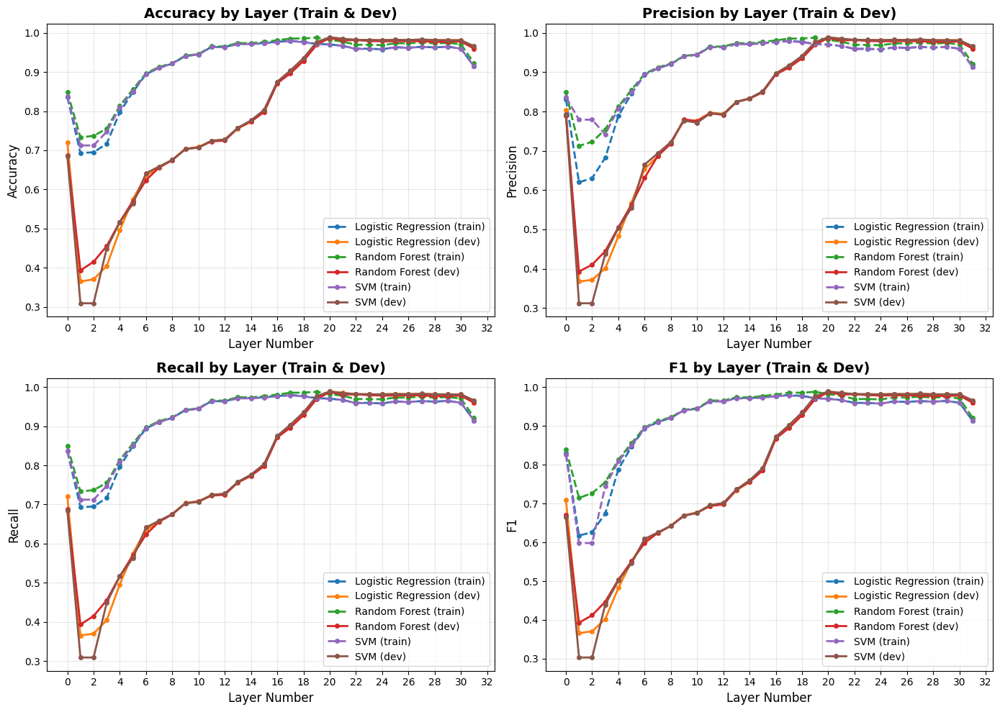

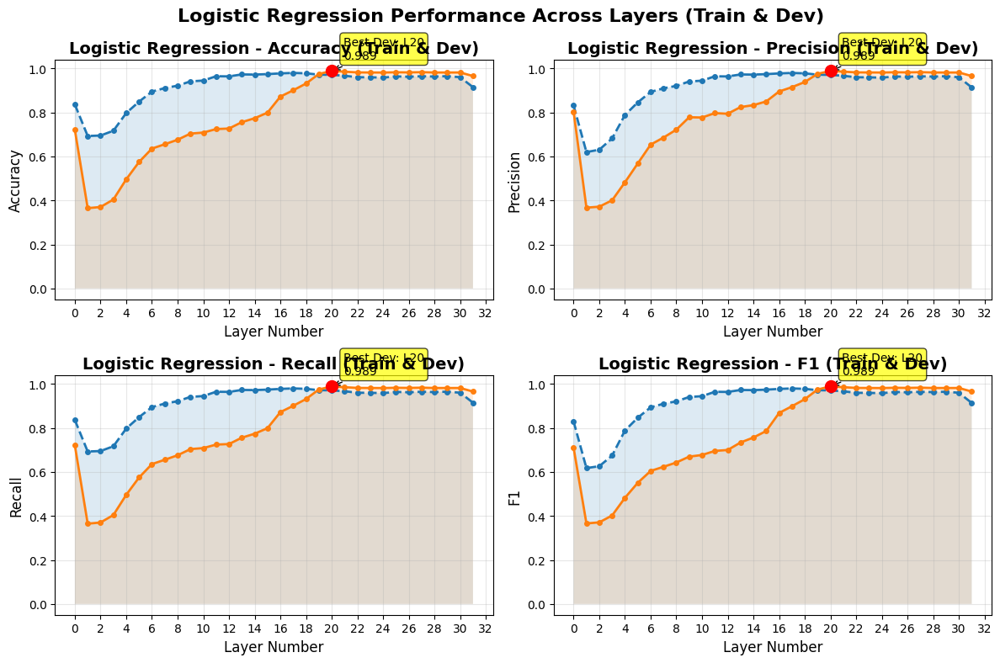

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

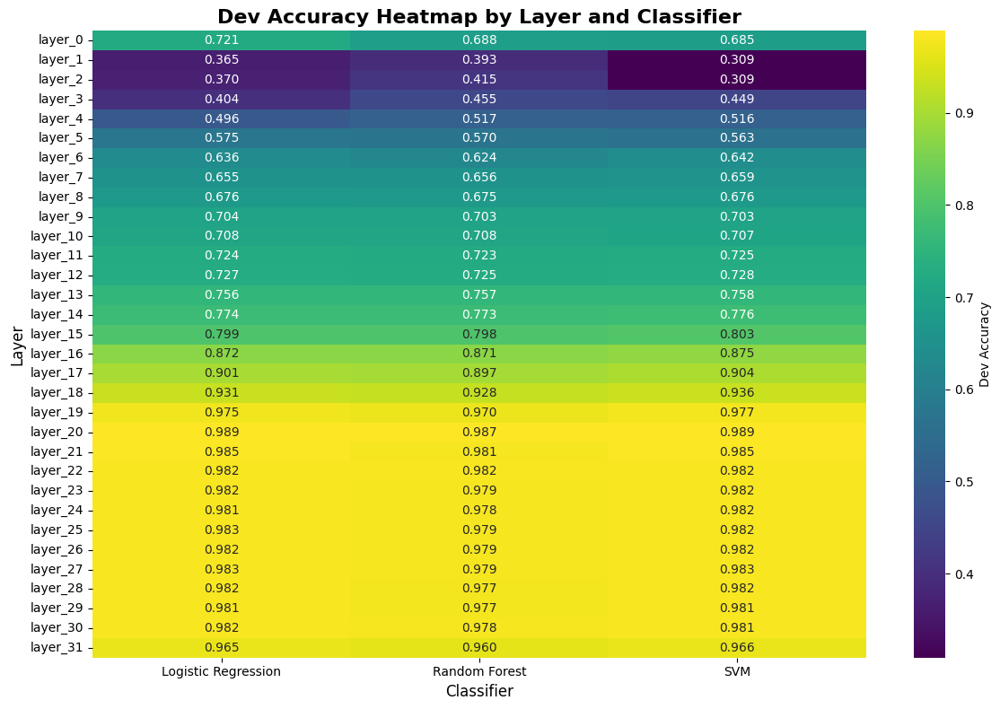

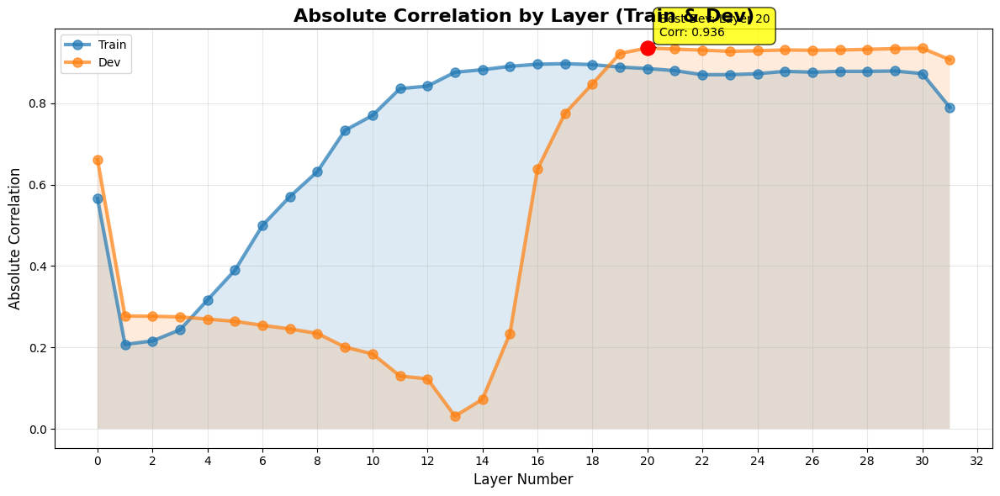

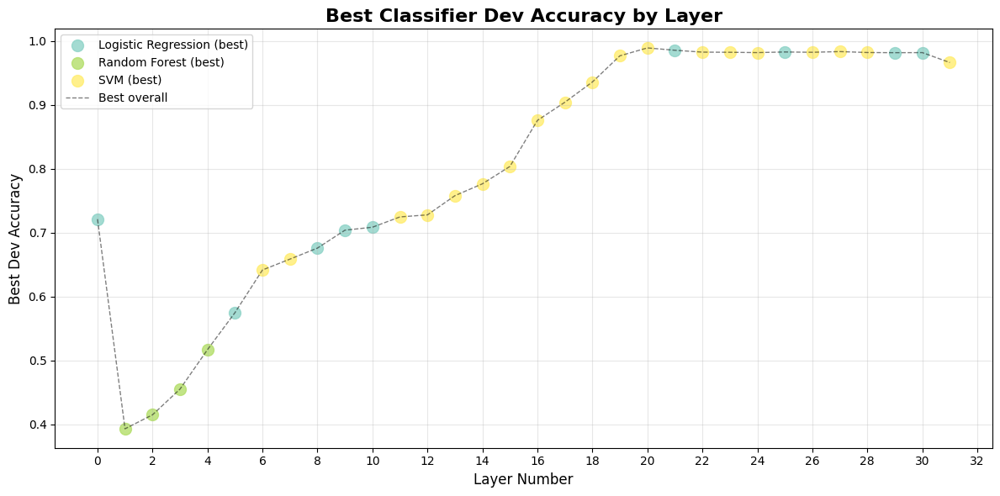

All plots saved to ./steering_vectors_dotProduct\plots

=== BEST LAYERS PER CLASSIFIER (Dev) ===
Logistic Regression: layer_20 (Dev Accuracy: 0.9886)
Random Forest: layer_20 (Dev Accuracy: 0.9872)
SVM: layer_20 (Dev Accuracy: 0.9889)

=== SUMMARY ===
'Total layers evaluated: 32'
'Total train samples: 28774'
'Total dev samples: 2501'
'\nBest dev correlation: layer_20 (r=0.9362)'
'Best dev F1 score: layer_20 with SVM (F1=0.9889)'

Top 5 layers by dev accuracy:
('   layer          classifier  dev_accuracy   dev_f1  dev_abs_correlation\n'
 'layer_20                 SVM      0.988878 0.988886             0.936216\n'
 'layer_20 Logistic Regression      0.988634 0.988641             0.936216\n'
 'layer_20       Random Forest      0.987167 0.987175             0.936216\n'
 'layer_21 Logistic Regression      0.985211 0.985225             0.933186\n'
 'layer_21                 SVM      0.984845 0.984860             0.933186')
'\nBest train F1 score: layer_19 with Random Forest (F1=0.9880)'


In [ ]:
data_train, data_dev_medicine = load_steering_data(save_dir = "../computed_steering_data/llama_steering_vectors3", domain_tag = "from_another_domain", alt_dir = "../computed_steering_data/llama_steering_vectors_medicine3")

# Calculate projections
layer_projections_train_medicine, layer_projections_dev_medicine  = calculate_projections(data_train, data_dev_finance, save_dir = "../computed_projection_data/steering_vectors_dotProduct_from_another_domain_medicine3")

# Evaluate all layers
results_df, classifier_dfs, best_model_info = evaluate_all_layers(layer_projections_train_medicine, layer_projections_dev_medicine, save_dir = "../computed_projection_data/steering_vectors_dotProduct_from_another_domain_medicine3")

# Create visualizations
plot_layer_performance(results_df)

# Print summary
print("\n=== SUMMARY ===")
pprint(f"Total layers evaluated: {len(results_df['layer'].unique())}")

# Number of samples per set
train_samples = data_train['metadata']['train_real_count'] + data_train['metadata']['train_fake_count']
dev_samples = data_dev_medicine['metadata']['dev_real_count'] + data_dev_medicine['metadata']['dev_fake_count']
pprint(f"Total train samples: {train_samples}")
pprint(f"Total dev samples: {dev_samples}")

# Best Correlation (Dev)
best_corr_layer = results_df.loc[results_df['dev_abs_correlation'].idxmax()]
pprint(f"\nBest dev correlation: {best_corr_layer['layer']} (r={best_corr_layer['dev_correlation']:.4f})")

#Best layer according to Dev-F1
best_f1_layer = results_df.loc[results_df['dev_f1'].idxmax()]
pprint(f"Best dev F1 score: {best_f1_layer['layer']} with {best_f1_layer['classifier']} (F1={best_f1_layer['dev_f1']:.4f})")

# Top 5 Layers оn Dev-Accuracy
print("\nTop 5 layers by dev accuracy:")
top_5 = results_df.nlargest(5, 'dev_accuracy')[['layer', 'classifier', 'dev_accuracy', 'dev_f1', 'dev_abs_correlation']]
pprint(top_5.to_string(index=False))

# Optional: Best training values
best_train_f1_layer = results_df.loc[results_df['train_f1'].idxmax()]
pprint(f"\nBest train F1 score: {best_train_f1_layer['layer']} with {best_train_f1_layer['classifier']} (F1={best_train_f1_layer['train_f1']:.4f})")

In [ ]:
shutil.make_archive('steering_vectors_dotProduct_from_another_domain_medicine3', 'zip', 'steering_vectors_dotProduct_from_another_domain_medicine3')

'c:\\Users\\DarMan\\stepik\\Projekt_2Sem_DLS\\Projekt\\steering_vectors_dotProduct_from_another_domain_medicine3.zip'

## Выводы из треитий части (перенос на медицинский домен):
- Ситуация аналогична эксперименту с финансовыми данными: При переносе домена (from general to specific language) видно, что слои 13-20 привносят свой маленький вклад в детекцию, но именно на 20 слое обучение стабилизируется: на всех графиках виден скачек. По этому эксперименту снова можно предположить неоднородность концепта "фейковость".

# Основной вывод из первой части с моделью llama-2-7b:
Эксперимент показал, что представление концепта "фейковости" в слоях LLM не статично: ключевая информация впервые появляется примерно на 13-м слое и далее усиливается, но окончательная значимость слоёв зависит от задачи и домена. На исходных данных именно слои 13–20 дают максимальный вклад в детекцию, причём классификаторы достигают стабильных и высоких результатов уже с этого диапазона. Однако при переносе на специализированные домены (финансовый, медицинский) вклад этих слоёв снижается, а решающую роль начинают играть более поздние слои, что указывает на доменно-специфическую структуру концепта "фейковости". Это подтверждает, что модель формирует сложные, многоуровневые представления, а "фейковость" — не универсальный, а контекстно-зависимый признак, проявляющийся по-разному в зависимости от лингвистической среды и задачи.